# Afriat

In [1]:
scan=0.1375

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

True

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

# tardis.MyModel.setup_wandb(
#     wandb_configurations=tardis.config.wandb,
#     hyperparams=dict(
#         model_params=model_params,
#         train_params=train_params,
#         dataset_params=dataset_params,
#     )
# )

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

CUDA backend failed to initialize: Found cuDNN version 8700, but JAX was built against version 8907, which is newer. The copy of cuDNN that is installed must be at least as new as the version against which JAX was built. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_figures
ID: hq960r50
Name: clean-pond-108
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_figures/runs/hq960r50
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240503_101835-hq960r50/files



GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


You are using a CUDA device ('NVIDIA A100-PCIE-40GB MIG 3g.20gb') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [MIG-1616462e-6e49-50af-903e-a8e6f17f9046]


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "
SLURM auto-requeueing enabled. Setting signal handlers.


Training:   0%|                                                                                                                                                                                                                                | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|                                                                                                                                                                                                                             | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2535,3227,9481
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2535,2573,1681,3454,1658,3342
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4461,10782
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 670,882,2258
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 670,629,427,836,391,857
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1123,2687
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|▎                                                                                                                                                                                                                  | 1/600 [00:12<2:08:43, 12.89s/it]

Epoch 1/600:   0%|▎                                                                                                                                                         | 1/600 [00:12<2:08:43, 12.89s/it, v_num=50_1, total_loss_train=3.71e+3, kl_local_train=43]

Epoch 2/600:   0%|▎                                                                                                                                                         | 1/600 [00:12<2:08:43, 12.89s/it, v_num=50_1, total_loss_train=3.71e+3, kl_local_train=43]

Epoch 2/600:   0%|▌                                                                                                                                                         | 2/600 [00:18<1:26:46,  8.71s/it, v_num=50_1, total_loss_train=3.71e+3, kl_local_train=43]

Epoch 2/600:   0%|▌                                                                                                                                                       | 2/600 [00:18<1:26:46,  8.71s/it, v_num=50_1, total_loss_train=3.21e+3, kl_local_train=56.7]

Epoch 3/600:   0%|▌                                                                                                                                                       | 2/600 [00:18<1:26:46,  8.71s/it, v_num=50_1, total_loss_train=3.21e+3, kl_local_train=56.7]

Epoch 3/600:   0%|▊                                                                                                                                                       | 3/600 [00:24<1:13:04,  7.34s/it, v_num=50_1, total_loss_train=3.21e+3, kl_local_train=56.7]

Epoch 3/600:   0%|▊                                                                                                                                                        | 3/600 [00:24<1:13:04,  7.34s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=55.6]

Epoch 4/600:   0%|▊                                                                                                                                                        | 3/600 [00:24<1:13:04,  7.34s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=55.6]

Epoch 4/600:   1%|█                                                                                                                                                        | 4/600 [00:31<1:10:16,  7.07s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=55.6]

Epoch 4/600:   1%|█                                                                                                                                                        | 4/600 [00:31<1:10:16,  7.07s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=51.7]

Epoch 5/600:   1%|█                                                                                                                                                        | 4/600 [00:31<1:10:16,  7.07s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=51.7]

Epoch 5/600:   1%|█▎                                                                                                                                                       | 5/600 [00:36<1:05:17,  6.58s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=51.7]

Epoch 5/600:   1%|█▎                                                                                                                                                      | 5/600 [00:36<1:05:17,  6.58s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=45.9]

Epoch 6/600:   1%|█▎                                                                                                                                                      | 5/600 [00:37<1:05:17,  6.58s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=45.9]

Epoch 6/600:   1%|█▌                                                                                                                                                      | 6/600 [00:43<1:07:00,  6.77s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=45.9]

Epoch 6/600:   1%|▏                   | 6/600 [00:43<1:07:00,  6.77s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|▏                   | 6/600 [00:43<1:07:00,  6.77s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|▏                   | 7/600 [00:50<1:05:08,  6.59s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|▏                   | 7/600 [00:50<1:05:08,  6.59s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=29.3, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏                   | 7/600 [00:50<1:05:08,  6.59s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=29.3, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▎                   | 8/600 [00:55<1:02:22,  6.32s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=29.3, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▎                   | 8/600 [00:55<1:02:22,  6.32s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=21.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 9/600:   1%|▎                   | 8/600 [00:55<1:02:22,  6.32s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=21.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▎                   | 9/600 [01:01<1:00:27,  6.14s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=21.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▎                   | 9/600 [01:01<1:00:27,  6.14s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=20.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▎                  | 9/600 [01:01<1:00:27,  6.14s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=20.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▎                 | 10/600 [01:08<1:02:18,  6.34s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=20.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▎                 | 10/600 [01:08<1:02:18,  6.34s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=24.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▎                 | 10/600 [01:09<1:02:18,  6.34s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=24.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▎                 | 11/600 [01:15<1:05:24,  6.66s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=24.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▎                   | 11/600 [01:15<1:05:24,  6.66s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=30.2, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0604, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0496]

Epoch 12/600:   2%|▎                   | 11/600 [01:15<1:05:24,  6.66s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=30.2, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0604, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0496]

Epoch 12/600:   2%|▍                   | 12/600 [01:22<1:05:09,  6.65s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=30.2, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0604, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0496]

Epoch 12/600:   2%|▍                   | 12/600 [01:22<1:05:09,  6.65s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0604, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0496]

Epoch 13/600:   2%|▍                   | 12/600 [01:22<1:05:09,  6.65s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0604, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0496]

Epoch 13/600:   2%|▍                   | 13/600 [01:28<1:04:30,  6.59s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=35.7, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0604, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0496]

Epoch 13/600:   2%|▍                   | 13/600 [01:28<1:04:30,  6.59s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0604, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0496]

Epoch 14/600:   2%|▍                   | 13/600 [01:28<1:04:30,  6.59s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0604, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0496]

Epoch 14/600:   2%|▍                   | 14/600 [01:36<1:06:33,  6.82s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0604, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0496]

Epoch 14/600:   2%|▍                   | 14/600 [01:36<1:06:33,  6.82s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0604, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0496]

Epoch 15/600:   2%|▍                   | 14/600 [01:36<1:06:33,  6.82s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0604, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0496]

Epoch 15/600:   2%|▌                   | 15/600 [01:41<1:03:14,  6.49s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0604, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0496]

Epoch 15/600:   2%|▌                   | 15/600 [01:41<1:03:14,  6.49s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=54.2, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0604, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0496]

Epoch 16/600:   2%|▌                   | 15/600 [01:42<1:03:14,  6.49s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=54.2, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0604, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0496]

Epoch 16/600:   3%|▌                   | 16/600 [01:48<1:03:53,  6.56s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=54.2, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0604, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0496]

Epoch 16/600:   3%|▌                  | 16/600 [01:48<1:03:53,  6.56s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=59.8, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0723]

Epoch 17/600:   3%|▌                  | 16/600 [01:48<1:03:53,  6.56s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=59.8, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0723]

Epoch 17/600:   3%|▌                  | 17/600 [01:54<1:01:32,  6.33s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=59.8, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0723]

Epoch 17/600:   3%|▌                  | 17/600 [01:54<1:01:32,  6.33s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=65.4, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0723]

Epoch 18/600:   3%|▌                  | 17/600 [01:54<1:01:32,  6.33s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=65.4, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0723]

Epoch 18/600:   3%|▋                    | 18/600 [02:00<59:45,  6.16s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=65.4, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0723]

Epoch 18/600:   3%|▋                    | 18/600 [02:00<59:45,  6.16s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=70.4, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0723]

Epoch 19/600:   3%|▋                    | 18/600 [02:00<59:45,  6.16s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=70.4, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0723]

Epoch 19/600:   3%|▋                    | 19/600 [02:05<58:24,  6.03s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=70.4, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0723]

Epoch 19/600:   3%|▋                    | 19/600 [02:05<58:24,  6.03s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=75.2, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0723]

Epoch 20/600:   3%|▋                    | 19/600 [02:05<58:24,  6.03s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=75.2, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0723]

Epoch 20/600:   3%|▋                    | 20/600 [02:11<57:28,  5.95s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=75.2, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0723]

Epoch 20/600:   3%|▋                    | 20/600 [02:11<57:28,  5.95s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=80.6, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0723]

Epoch 21/600:   3%|▋                    | 20/600 [02:12<57:28,  5.95s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=80.6, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0723]

Epoch 21/600:   4%|▋                    | 21/600 [02:18<59:54,  6.21s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=80.6, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0723]

Epoch 21/600:   4%|▋                    | 21/600 [02:18<59:54,  6.21s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=85.7, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0925]

Epoch 22/600:   4%|▋                    | 21/600 [02:18<59:54,  6.21s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=85.7, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0925]

Epoch 22/600:   4%|▊                    | 22/600 [02:24<59:50,  6.21s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=85.7, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0925]

Epoch 22/600:   4%|▊                    | 22/600 [02:24<59:50,  6.21s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=89.1, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0925]

Epoch 23/600:   4%|▊                    | 22/600 [02:24<59:50,  6.21s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=89.1, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0925]

Epoch 23/600:   4%|▋                  | 23/600 [02:31<1:01:18,  6.37s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=89.1, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0925]

Epoch 23/600:   4%|▋                  | 23/600 [02:31<1:01:18,  6.37s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=92.4, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0925]

Epoch 24/600:   4%|▋                  | 23/600 [02:31<1:01:18,  6.37s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=92.4, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0925]

Epoch 24/600:   4%|▊                    | 24/600 [02:37<59:36,  6.21s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=92.4, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0925]

Epoch 24/600:   4%|▊                    | 24/600 [02:37<59:36,  6.21s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=97.5, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0925]

Epoch 25/600:   4%|▊                    | 24/600 [02:37<59:36,  6.21s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=97.5, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0925]

Epoch 25/600:   4%|▊                  | 25/600 [02:44<1:03:10,  6.59s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=97.5, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0925]

Epoch 25/600:   4%|▊                  | 25/600 [02:44<1:03:10,  6.59s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=99.6, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0925]

Epoch 26/600:   4%|▊                  | 25/600 [02:45<1:03:10,  6.59s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=99.6, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0925]

Epoch 26/600:   4%|▊                  | 26/600 [02:51<1:03:41,  6.66s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=99.6, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0925]

Epoch 26/600:   4%|▉                    | 26/600 [02:51<1:03:41,  6.66s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=102, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.104]

Epoch 27/600:   4%|▉                    | 26/600 [02:51<1:03:41,  6.66s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=102, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.104]

Epoch 27/600:   4%|▉                    | 27/600 [02:57<1:00:54,  6.38s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=102, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.104]

Epoch 27/600:   4%|▉                    | 27/600 [02:57<1:00:54,  6.38s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=105, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.104]

Epoch 28/600:   4%|▉                    | 27/600 [02:57<1:00:54,  6.38s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=105, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.104]

Epoch 28/600:   5%|█                      | 28/600 [03:03<59:30,  6.24s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=105, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.104]

Epoch 28/600:   5%|█                      | 28/600 [03:03<59:30,  6.24s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=107, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.104]

Epoch 29/600:   5%|█                      | 28/600 [03:03<59:30,  6.24s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=107, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.104]

Epoch 29/600:   5%|█                      | 29/600 [03:09<57:58,  6.09s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=107, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.104]

Epoch 29/600:   5%|█                      | 29/600 [03:09<57:58,  6.09s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.104]

Epoch 30/600:   5%|█                      | 29/600 [03:09<57:58,  6.09s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.104]

Epoch 30/600:   5%|█▏                     | 30/600 [03:14<57:02,  6.00s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.104]

Epoch 30/600:   5%|█▏                     | 30/600 [03:14<57:02,  6.00s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=113, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.104]

Epoch 31/600:   5%|█▏                     | 30/600 [03:15<57:02,  6.00s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=113, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.104]

Epoch 31/600:   5%|█▏                     | 31/600 [03:21<59:27,  6.27s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=113, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.104]

Epoch 31/600:   5%|█▎                        | 31/600 [03:21<59:27,  6.27s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=112, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 32/600:   5%|█▎                        | 31/600 [03:21<59:27,  6.27s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=112, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 32/600:   5%|█▍                        | 32/600 [03:27<57:47,  6.10s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=112, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 32/600:   5%|█▍                        | 32/600 [03:27<57:47,  6.10s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 33/600:   5%|█▍                        | 32/600 [03:27<57:47,  6.10s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 33/600:   6%|█▍                        | 33/600 [03:33<56:43,  6.00s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 33/600:   6%|█▍                        | 33/600 [03:33<56:43,  6.00s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 34/600:   6%|█▍                        | 33/600 [03:33<56:43,  6.00s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 34/600:   6%|█▍                        | 34/600 [03:38<56:06,  5.95s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 34/600:   6%|█▍                        | 34/600 [03:39<56:06,  5.95s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 35/600:   6%|█▍                        | 34/600 [03:39<56:06,  5.95s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 35/600:   6%|█▌                        | 35/600 [03:45<58:07,  6.17s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 35/600:   6%|█▌                        | 35/600 [03:45<58:07,  6.17s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 36/600:   6%|█▌                        | 35/600 [03:46<58:07,  6.17s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 36/600:   6%|█▍                      | 36/600 [03:54<1:04:22,  6.85s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 36/600:   6%|█▌                       | 36/600 [03:54<1:04:22,  6.85s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 37/600:   6%|█▌                       | 36/600 [03:54<1:04:22,  6.85s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 37/600:   6%|█▌                       | 37/600 [04:00<1:01:46,  6.58s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 37/600:   6%|█▌                       | 37/600 [04:00<1:01:46,  6.58s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 38/600:   6%|█▌                       | 37/600 [04:00<1:01:46,  6.58s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 38/600:   6%|█▋                         | 38/600 [04:05<59:14,  6.32s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 38/600:   6%|█▋                         | 38/600 [04:05<59:14,  6.32s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 39/600:   6%|█▋                         | 38/600 [04:05<59:14,  6.32s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 39/600:   6%|█▊                         | 39/600 [04:11<57:19,  6.13s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 39/600:   6%|█▊                         | 39/600 [04:11<57:19,  6.13s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 40/600:   6%|█▊                         | 39/600 [04:11<57:19,  6.13s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 40/600:   7%|█▊                         | 40/600 [04:17<56:06,  6.01s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 40/600:   7%|█▊                         | 40/600 [04:17<56:06,  6.01s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 41/600:   7%|█▊                         | 40/600 [04:18<56:06,  6.01s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 41/600:   7%|█▊                         | 41/600 [04:23<58:03,  6.23s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 41/600:   7%|█▊                        | 41/600 [04:23<58:03,  6.23s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 42/600:   7%|█▊                        | 41/600 [04:23<58:03,  6.23s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 42/600:   7%|█▊                        | 42/600 [04:29<56:38,  6.09s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 42/600:   7%|█▊                        | 42/600 [04:29<56:38,  6.09s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 43/600:   7%|█▊                        | 42/600 [04:29<56:38,  6.09s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 43/600:   7%|█▊                        | 43/600 [04:35<55:31,  5.98s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 43/600:   7%|█▊                        | 43/600 [04:35<55:31,  5.98s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 44/600:   7%|█▊                        | 43/600 [04:35<55:31,  5.98s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 44/600:   7%|█▉                        | 44/600 [04:41<54:54,  5.93s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 44/600:   7%|█▉                        | 44/600 [04:41<54:54,  5.93s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 45/600:   7%|█▉                        | 44/600 [04:41<54:54,  5.93s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 45/600:   8%|█▉                        | 45/600 [04:48<59:42,  6.45s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 45/600:   8%|█▉                        | 45/600 [04:48<59:42,  6.45s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 46/600:   8%|█▉                        | 45/600 [04:49<59:42,  6.45s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 46/600:   8%|█▊                      | 46/600 [04:55<1:00:35,  6.56s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 46/600:   8%|█▊                      | 46/600 [04:55<1:00:35,  6.56s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 47/600:   8%|█▊                      | 46/600 [04:55<1:00:35,  6.56s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 47/600:   8%|██                        | 47/600 [05:01<58:19,  6.33s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 47/600:   8%|██                         | 47/600 [05:01<58:19,  6.33s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 48/600:   8%|██                         | 47/600 [05:01<58:19,  6.33s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 48/600:   8%|██▏                        | 48/600 [05:07<56:33,  6.15s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 48/600:   8%|██▏                        | 48/600 [05:07<56:33,  6.15s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 49/600:   8%|██▏                        | 48/600 [05:07<56:33,  6.15s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 49/600:   8%|██▏                        | 49/600 [05:13<56:17,  6.13s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 49/600:   8%|██▏                        | 49/600 [05:13<56:17,  6.13s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 50/600:   8%|██▏                        | 49/600 [05:13<56:17,  6.13s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 50/600:   8%|██▎                        | 50/600 [05:19<55:15,  6.03s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 50/600:   8%|██▎                        | 50/600 [05:19<55:15,  6.03s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 51/600:   8%|██▎                        | 50/600 [05:20<55:15,  6.03s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 51/600:   8%|██▎                        | 51/600 [05:25<56:57,  6.23s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 51/600:   8%|██▎                        | 51/600 [05:25<56:57,  6.23s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 52/600:   8%|██▎                        | 51/600 [05:25<56:57,  6.23s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 52/600:   9%|██▏                      | 52/600 [05:33<1:00:53,  6.67s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 52/600:   9%|██▏                      | 52/600 [05:33<1:00:53,  6.67s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 53/600:   9%|██▏                      | 52/600 [05:33<1:00:53,  6.67s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 53/600:   9%|██▍                        | 53/600 [05:39<58:25,  6.41s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 53/600:   9%|██▎                       | 53/600 [05:39<58:25,  6.41s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=99.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 54/600:   9%|██▎                       | 53/600 [05:39<58:25,  6.41s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=99.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 54/600:   9%|██▎                       | 54/600 [05:45<56:34,  6.22s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=99.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 54/600:   9%|██▎                       | 54/600 [05:45<56:34,  6.22s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=99.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 55/600:   9%|██▎                       | 54/600 [05:45<56:34,  6.22s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=99.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 55/600:   9%|██▍                       | 55/600 [05:50<55:14,  6.08s/it, v_num=50_1, total_loss_train=3.2e+3, kl_local_train=99.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 55/600:   9%|██▎                      | 55/600 [05:50<55:14,  6.08s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=98.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 56/600:   9%|██▎                      | 55/600 [05:51<55:14,  6.08s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=98.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 56/600:   9%|██▎                      | 56/600 [05:57<56:58,  6.28s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=98.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 56/600:   9%|██▎                      | 56/600 [05:57<56:58,  6.28s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=98.6, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 57/600:   9%|██▎                      | 56/600 [05:57<56:58,  6.28s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=98.6, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 57/600:  10%|██▍                      | 57/600 [06:03<55:24,  6.12s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=98.6, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 57/600:  10%|██▍                      | 57/600 [06:03<55:24,  6.12s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=97.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 58/600:  10%|██▍                      | 57/600 [06:03<55:24,  6.12s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=97.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 58/600:  10%|██▍                      | 58/600 [06:09<54:17,  6.01s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=97.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 58/600:  10%|██▍                      | 58/600 [06:09<54:17,  6.01s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=95.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 59/600:  10%|██▍                      | 58/600 [06:09<54:17,  6.01s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=95.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 59/600:  10%|██▍                      | 59/600 [06:15<56:31,  6.27s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=95.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 59/600:  10%|██▍                      | 59/600 [06:15<56:31,  6.27s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=96.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 60/600:  10%|██▍                      | 59/600 [06:15<56:31,  6.27s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=96.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 60/600:  10%|██▌                      | 60/600 [06:21<54:34,  6.06s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=96.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 60/600:  10%|██▌                      | 60/600 [06:21<54:34,  6.06s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=95.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 61/600:  10%|██▌                      | 60/600 [06:22<54:34,  6.06s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=95.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 61/600:  10%|██▎                    | 61/600 [06:30<1:01:14,  6.82s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=95.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 61/600:  10%|██▎                    | 61/600 [06:30<1:01:14,  6.82s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=94.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 62/600:  10%|██▎                    | 61/600 [06:30<1:01:14,  6.82s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=94.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 62/600:  10%|██▍                    | 62/600 [06:37<1:01:36,  6.87s/it, v_num=50_1, total_loss_train=3.19e+3, kl_local_train=94.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 62/600:  10%|██▍                    | 62/600 [06:37<1:01:36,  6.87s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=92.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 63/600:  10%|██▍                    | 62/600 [06:37<1:01:36,  6.87s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=92.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 63/600:  10%|██▋                      | 63/600 [06:42<58:39,  6.55s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=92.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 63/600:  10%|██▋                      | 63/600 [06:42<58:39,  6.55s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=91.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 64/600:  10%|██▋                      | 63/600 [06:42<58:39,  6.55s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=91.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 64/600:  11%|██▋                      | 64/600 [06:48<56:23,  6.31s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=91.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 64/600:  11%|██▋                      | 64/600 [06:48<56:23,  6.31s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=90.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 65/600:  11%|██▋                      | 64/600 [06:48<56:23,  6.31s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=90.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 65/600:  11%|██▋                      | 65/600 [06:55<56:43,  6.36s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=90.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 65/600:  11%|██▋                      | 65/600 [06:55<56:43,  6.36s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=90.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 66/600:  11%|██▋                      | 65/600 [06:56<56:43,  6.36s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=90.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 66/600:  11%|██▊                      | 66/600 [07:02<59:47,  6.72s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=90.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 66/600:  11%|██▊                      | 66/600 [07:02<59:47,  6.72s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=89.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 67/600:  11%|██▊                      | 66/600 [07:02<59:47,  6.72s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=89.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 67/600:  11%|██▊                      | 67/600 [07:08<57:14,  6.44s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=89.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 67/600:  11%|██▊                      | 67/600 [07:08<57:14,  6.44s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=88.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 68/600:  11%|██▊                      | 67/600 [07:08<57:14,  6.44s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=88.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 68/600:  11%|██▊                      | 68/600 [07:15<59:19,  6.69s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=88.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 68/600:  11%|██▊                      | 68/600 [07:15<59:19,  6.69s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=88.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 69/600:  11%|██▊                      | 68/600 [07:15<59:19,  6.69s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=88.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 69/600:  12%|██▉                      | 69/600 [07:21<56:41,  6.41s/it, v_num=50_1, total_loss_train=3.18e+3, kl_local_train=88.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 69/600:  12%|██▉                      | 69/600 [07:21<56:41,  6.41s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=88.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 70/600:  12%|██▉                      | 69/600 [07:21<56:41,  6.41s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=88.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 70/600:  12%|██▉                      | 70/600 [07:27<56:23,  6.38s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=88.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 70/600:  12%|██▉                      | 70/600 [07:27<56:23,  6.38s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=87.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 71/600:  12%|██▉                      | 70/600 [07:28<56:23,  6.38s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=87.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 71/600:  12%|██▉                      | 71/600 [07:34<57:21,  6.51s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=87.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 71/600:  12%|██▉                      | 71/600 [07:34<57:21,  6.51s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=86.4, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 72/600:  12%|██▉                      | 71/600 [07:34<57:21,  6.51s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=86.4, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 72/600:  12%|███                      | 72/600 [07:40<55:14,  6.28s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=86.4, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 72/600:  12%|███                      | 72/600 [07:40<55:14,  6.28s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=85.8, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 73/600:  12%|███                      | 72/600 [07:40<55:14,  6.28s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=85.8, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 73/600:  12%|███                      | 73/600 [07:47<56:22,  6.42s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=85.8, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 73/600:  12%|███                      | 73/600 [07:47<56:22,  6.42s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=85.3, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 74/600:  12%|███                      | 73/600 [07:47<56:22,  6.42s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=85.3, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 74/600:  12%|███                      | 74/600 [07:52<54:37,  6.23s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=85.3, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 74/600:  12%|███                      | 74/600 [07:52<54:37,  6.23s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=85.2, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 75/600:  12%|███                      | 74/600 [07:52<54:37,  6.23s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=85.2, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 75/600:  12%|███▏                     | 75/600 [07:59<55:59,  6.40s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=85.2, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 75/600:  12%|███▏                     | 75/600 [07:59<55:59,  6.40s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=84.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 76/600:  12%|███▏                     | 75/600 [08:00<55:59,  6.40s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=84.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 76/600:  13%|███▏                     | 76/600 [08:07<59:51,  6.85s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=84.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 76/600:  13%|███▏                     | 76/600 [08:07<59:51,  6.85s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=83.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 77/600:  13%|███▏                     | 76/600 [08:07<59:51,  6.85s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=83.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 77/600:  13%|███▏                     | 77/600 [08:13<56:53,  6.53s/it, v_num=50_1, total_loss_train=3.17e+3, kl_local_train=83.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 77/600:  13%|███▏                     | 77/600 [08:13<56:53,  6.53s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=83.4, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 78/600:  13%|███▏                     | 77/600 [08:13<56:53,  6.53s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=83.4, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 78/600:  13%|███▎                     | 78/600 [08:19<54:46,  6.30s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=83.4, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 78/600:  13%|███▎                     | 78/600 [08:19<54:46,  6.30s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=82.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 79/600:  13%|███▎                     | 78/600 [08:19<54:46,  6.30s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=82.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 79/600:  13%|███▎                     | 79/600 [08:25<53:26,  6.15s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=82.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 79/600:  13%|███▎                     | 79/600 [08:25<53:26,  6.15s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=82.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 80/600:  13%|███▎                     | 79/600 [08:25<53:26,  6.15s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=82.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 80/600:  13%|███▎                     | 80/600 [08:30<52:12,  6.02s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=82.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 80/600:  13%|███▎                     | 80/600 [08:30<52:12,  6.02s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=82.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 81/600:  13%|███▎                     | 80/600 [08:31<52:12,  6.02s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=82.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 81/600:  14%|███▍                     | 81/600 [08:37<54:04,  6.25s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=82.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 81/600:  14%|███▌                      | 81/600 [08:37<54:04,  6.25s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=81.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 82/600:  14%|███▌                      | 81/600 [08:37<54:04,  6.25s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=81.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 82/600:  14%|███▌                      | 82/600 [08:43<53:21,  6.18s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=81.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 82/600:  14%|███▌                      | 82/600 [08:43<53:21,  6.18s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=81.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 83/600:  14%|███▌                      | 82/600 [08:43<53:21,  6.18s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=81.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 83/600:  14%|███▌                      | 83/600 [08:49<53:01,  6.15s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=81.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 83/600:  14%|███▌                      | 83/600 [08:49<53:01,  6.15s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=79.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 84/600:  14%|███▌                      | 83/600 [08:49<53:01,  6.15s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=79.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 84/600:  14%|███▋                      | 84/600 [08:55<51:28,  5.99s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=79.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 84/600:  14%|███▋                      | 84/600 [08:55<51:28,  5.99s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=79.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 85/600:  14%|███▋                      | 84/600 [08:55<51:28,  5.99s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=79.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 85/600:  14%|███▋                      | 85/600 [09:01<52:19,  6.10s/it, v_num=50_1, total_loss_train=3.16e+3, kl_local_train=79.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 85/600:  14%|███▋                      | 85/600 [09:01<52:19,  6.10s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=78.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 86/600:  14%|███▋                      | 85/600 [09:02<52:19,  6.10s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=78.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 86/600:  14%|███▋                      | 86/600 [09:08<53:57,  6.30s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=78.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 86/600:  14%|███▌                     | 86/600 [09:08<53:57,  6.30s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=77.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 87/600:  14%|███▌                     | 86/600 [09:08<53:57,  6.30s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=77.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 87/600:  14%|███▌                     | 87/600 [09:15<57:01,  6.67s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=77.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 87/600:  14%|███▌                     | 87/600 [09:15<57:01,  6.67s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=77.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 88/600:  14%|███▌                     | 87/600 [09:15<57:01,  6.67s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=77.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 88/600:  15%|███▋                     | 88/600 [09:22<57:06,  6.69s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=77.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 88/600:  15%|███▋                     | 88/600 [09:22<57:06,  6.69s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=77.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 89/600:  15%|███▋                     | 88/600 [09:22<57:06,  6.69s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=77.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 89/600:  15%|███▋                     | 89/600 [09:28<54:29,  6.40s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=77.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 89/600:  15%|████                       | 89/600 [09:28<54:29,  6.40s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=77, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 90/600:  15%|████                       | 89/600 [09:28<54:29,  6.40s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=77, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 90/600:  15%|████                       | 90/600 [09:34<52:37,  6.19s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=77, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 90/600:  15%|███▊                     | 90/600 [09:34<52:37,  6.19s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=76.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 91/600:  15%|███▊                     | 90/600 [09:35<52:37,  6.19s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=76.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 91/600:  15%|███▍                   | 91/600 [09:43<1:00:07,  7.09s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=76.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 91/600:  15%|███▍                   | 91/600 [09:43<1:00:07,  7.09s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 92/600:  15%|███▍                   | 91/600 [09:43<1:00:07,  7.09s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 92/600:  15%|███▊                     | 92/600 [09:48<56:41,  6.70s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 92/600:  15%|███▊                     | 92/600 [09:48<56:41,  6.70s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=75.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 93/600:  15%|███▊                     | 92/600 [09:49<56:41,  6.70s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=75.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 93/600:  16%|███▉                     | 93/600 [09:54<53:59,  6.39s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=75.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 93/600:  16%|███▉                     | 93/600 [09:54<53:59,  6.39s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=75.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 94/600:  16%|███▉                     | 93/600 [09:54<53:59,  6.39s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=75.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 94/600:  16%|███▉                     | 94/600 [10:00<53:32,  6.35s/it, v_num=50_1, total_loss_train=3.15e+3, kl_local_train=75.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 94/600:  16%|███▉                     | 94/600 [10:00<53:32,  6.35s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=74.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 95/600:  16%|███▉                     | 94/600 [10:00<53:32,  6.35s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=74.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 95/600:  16%|███▉                     | 95/600 [10:06<51:56,  6.17s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=74.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 95/600:  16%|███▉                     | 95/600 [10:06<51:56,  6.17s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=74.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 96/600:  16%|███▉                     | 95/600 [10:07<51:56,  6.17s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=74.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 96/600:  16%|████                     | 96/600 [10:14<55:20,  6.59s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=74.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 96/600:  16%|████▎                      | 96/600 [10:14<55:20,  6.59s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=74, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 97/600:  16%|████▎                      | 96/600 [10:14<55:20,  6.59s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=74, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 97/600:  16%|████▎                      | 97/600 [10:22<58:43,  7.01s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=74, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 97/600:  16%|████                     | 97/600 [10:22<58:43,  7.01s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=73.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 98/600:  16%|████                     | 97/600 [10:22<58:43,  7.01s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=73.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 98/600:  16%|████                     | 98/600 [10:29<59:44,  7.14s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=73.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 98/600:  16%|████                     | 98/600 [10:29<59:44,  7.14s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=72.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 99/600:  16%|████                     | 98/600 [10:29<59:44,  7.14s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=72.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 99/600:  16%|████▏                    | 99/600 [10:35<55:44,  6.68s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=72.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 99/600:  16%|████▏                    | 99/600 [10:35<55:44,  6.68s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=72.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 100/600:  16%|███▉                    | 99/600 [10:35<55:44,  6.68s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=72.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 100/600:  17%|███▊                   | 100/600 [10:41<53:22,  6.41s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=72.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 100/600:  17%|███▊                   | 100/600 [10:41<53:22,  6.41s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=72.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 101/600:  17%|███▊                   | 100/600 [10:42<53:22,  6.41s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=72.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 101/600:  17%|███▊                   | 101/600 [10:47<54:15,  6.52s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=72.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 101/600:  17%|████                    | 101/600 [10:47<54:15,  6.52s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=71.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 102/600:  17%|████                    | 101/600 [10:47<54:15,  6.52s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=71.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 102/600:  17%|████                    | 102/600 [10:53<52:59,  6.38s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=71.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 102/600:  17%|████                    | 102/600 [10:53<52:59,  6.38s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=71.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 103/600:  17%|████                    | 102/600 [10:53<52:59,  6.38s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=71.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 103/600:  17%|████                    | 103/600 [11:00<53:50,  6.50s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=71.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 103/600:  17%|████                    | 103/600 [11:00<53:50,  6.50s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=70.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 104/600:  17%|████                    | 103/600 [11:00<53:50,  6.50s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=70.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 104/600:  17%|████▏                   | 104/600 [11:06<52:02,  6.29s/it, v_num=50_1, total_loss_train=3.14e+3, kl_local_train=70.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 104/600:  17%|████▏                   | 104/600 [11:06<52:02,  6.29s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=70.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 105/600:  17%|████▏                   | 104/600 [11:06<52:02,  6.29s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=70.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 105/600:  18%|████▏                   | 105/600 [11:12<50:27,  6.12s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=70.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 105/600:  18%|████▏                   | 105/600 [11:12<50:27,  6.12s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=70.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 106/600:  18%|████▏                   | 105/600 [11:13<50:27,  6.12s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=70.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 106/600:  18%|████▏                   | 106/600 [11:19<52:10,  6.34s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=70.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 106/600:  18%|████▏                   | 106/600 [11:19<52:10,  6.34s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=70.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 107/600:  18%|████▏                   | 106/600 [11:19<52:10,  6.34s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=70.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 107/600:  18%|████▎                   | 107/600 [11:24<50:46,  6.18s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=70.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 107/600:  18%|████▎                   | 107/600 [11:24<50:46,  6.18s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=69.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 108/600:  18%|████▎                   | 107/600 [11:24<50:46,  6.18s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=69.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 108/600:  18%|████▎                   | 108/600 [11:31<51:30,  6.28s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=69.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 108/600:  18%|████▎                   | 108/600 [11:31<51:30,  6.28s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=69.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 109/600:  18%|████▎                   | 108/600 [11:31<51:30,  6.28s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=69.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 109/600:  18%|████▎                   | 109/600 [11:37<50:04,  6.12s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=69.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 109/600:  18%|████▎                   | 109/600 [11:37<50:04,  6.12s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=68.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 110/600:  18%|████▎                   | 109/600 [11:37<50:04,  6.12s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=68.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 110/600:  18%|████▍                   | 110/600 [11:43<50:42,  6.21s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=68.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 110/600:  18%|████▍                   | 110/600 [11:43<50:42,  6.21s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=68.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 111/600:  18%|████▍                   | 110/600 [11:44<50:42,  6.21s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=68.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 111/600:  18%|████▍                   | 111/600 [11:50<51:59,  6.38s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=68.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 111/600:  18%|████▊                     | 111/600 [11:50<51:59,  6.38s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=68, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 112/600:  18%|████▊                     | 111/600 [11:50<51:59,  6.38s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=68, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 112/600:  19%|████▊                     | 112/600 [11:56<50:17,  6.18s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=68, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 112/600:  19%|████▍                   | 112/600 [11:56<50:17,  6.18s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=67.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 113/600:  19%|████▍                   | 112/600 [11:56<50:17,  6.18s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=67.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 113/600:  19%|████▌                   | 113/600 [12:03<52:08,  6.42s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=67.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 113/600:  19%|████▌                   | 113/600 [12:03<52:08,  6.42s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=67.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 114/600:  19%|████▌                   | 113/600 [12:03<52:08,  6.42s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=67.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 114/600:  19%|████▌                   | 114/600 [12:09<52:54,  6.53s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=67.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 114/600:  19%|████▉                     | 114/600 [12:09<52:54,  6.53s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=68, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 115/600:  19%|████▉                     | 114/600 [12:09<52:54,  6.53s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=68, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 115/600:  19%|████▉                     | 115/600 [12:16<52:19,  6.47s/it, v_num=50_1, total_loss_train=3.13e+3, kl_local_train=68, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 115/600:  19%|████▌                   | 115/600 [12:16<52:19,  6.47s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=67.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 116/600:  19%|████▌                   | 115/600 [12:17<52:19,  6.47s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=67.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 116/600:  19%|████▋                   | 116/600 [12:22<53:03,  6.58s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=67.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 116/600:  19%|████▋                   | 116/600 [12:22<53:03,  6.58s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 117/600:  19%|████▋                   | 116/600 [12:22<53:03,  6.58s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 117/600:  20%|████▋                   | 117/600 [12:28<51:13,  6.36s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 117/600:  20%|████▋                   | 117/600 [12:28<51:13,  6.36s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=66.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 118/600:  20%|████▋                   | 117/600 [12:28<51:13,  6.36s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=66.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 118/600:  20%|████▋                   | 118/600 [12:34<49:52,  6.21s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=66.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 118/600:  20%|████▋                   | 118/600 [12:34<49:52,  6.21s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=66.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 119/600:  20%|████▋                   | 118/600 [12:34<49:52,  6.21s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=66.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 119/600:  20%|████▊                   | 119/600 [12:40<48:45,  6.08s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=66.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 119/600:  20%|████▊                   | 119/600 [12:40<48:45,  6.08s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=66.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 120/600:  20%|████▊                   | 119/600 [12:40<48:45,  6.08s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=66.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 120/600:  20%|████▊                   | 120/600 [12:46<47:56,  5.99s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=66.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 120/600:  20%|████▊                   | 120/600 [12:46<47:56,  5.99s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=66.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 121/600:  20%|████▊                   | 120/600 [12:47<47:56,  5.99s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=66.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 121/600:  20%|████▊                   | 121/600 [12:53<49:52,  6.25s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=66.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 121/600:  20%|████▋                  | 121/600 [12:53<49:52,  6.25s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=65.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 122/600:  20%|████▋                  | 121/600 [12:53<49:52,  6.25s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=65.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 122/600:  20%|████▋                  | 122/600 [12:59<51:14,  6.43s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=65.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 122/600:  20%|████▋                  | 122/600 [12:59<51:14,  6.43s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 123/600:  20%|████▋                  | 122/600 [12:59<51:14,  6.43s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 123/600:  20%|████▋                  | 123/600 [13:06<51:53,  6.53s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 123/600:  20%|████▋                  | 123/600 [13:06<51:53,  6.53s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=65.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 124/600:  20%|████▋                  | 123/600 [13:06<51:53,  6.53s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=65.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 124/600:  21%|████▊                  | 124/600 [13:12<49:58,  6.30s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=65.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 124/600:  21%|████▊                  | 124/600 [13:12<49:58,  6.30s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=64.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 125/600:  21%|████▊                  | 124/600 [13:12<49:58,  6.30s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=64.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 125/600:  21%|████▊                  | 125/600 [13:18<49:39,  6.27s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=64.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 125/600:  21%|████▊                  | 125/600 [13:18<49:39,  6.27s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 126/600:  21%|████▊                  | 125/600 [13:19<49:39,  6.27s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 126/600:  21%|████▊                  | 126/600 [13:25<50:17,  6.37s/it, v_num=50_1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 126/600:  21%|█████                   | 126/600 [13:25<50:17,  6.37s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=64, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 127/600:  21%|█████                   | 126/600 [13:25<50:17,  6.37s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=64, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 127/600:  21%|█████                   | 127/600 [13:30<48:19,  6.13s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=64, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 127/600:  21%|████▋                 | 127/600 [13:30<48:19,  6.13s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=64.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 128/600:  21%|████▋                 | 127/600 [13:30<48:19,  6.13s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=64.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 128/600:  21%|████▋                 | 128/600 [13:36<46:56,  5.97s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=64.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 128/600:  21%|████▋                 | 128/600 [13:36<46:56,  5.97s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=63.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 129/600:  21%|████▋                 | 128/600 [13:36<46:56,  5.97s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=63.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 129/600:  22%|████▋                 | 129/600 [13:42<46:00,  5.86s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=63.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 129/600:  22%|████▋                 | 129/600 [13:42<46:00,  5.86s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 130/600:  22%|████▋                 | 129/600 [13:42<46:00,  5.86s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 130/600:  22%|████▊                 | 130/600 [13:48<48:04,  6.14s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 130/600:  22%|████▊                 | 130/600 [13:48<48:04,  6.14s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 131/600:  22%|████▊                 | 130/600 [13:49<48:04,  6.14s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 131/600:  22%|████▊                 | 131/600 [13:55<49:42,  6.36s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 131/600:  22%|████▊                 | 131/600 [13:55<49:42,  6.36s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.103]

Epoch 132/600:  22%|████▊                 | 131/600 [13:55<49:42,  6.36s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.103]

Epoch 132/600:  22%|████▊                 | 132/600 [14:01<48:15,  6.19s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.103]

Epoch 132/600:  22%|████▊                 | 132/600 [14:01<48:15,  6.19s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=62.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.103]

Epoch 133/600:  22%|████▊                 | 132/600 [14:01<48:15,  6.19s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=62.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.103]

Epoch 133/600:  22%|████▉                 | 133/600 [14:07<48:17,  6.20s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=62.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.103]

Epoch 133/600:  22%|████▉                 | 133/600 [14:07<48:17,  6.20s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=62.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.103]

Epoch 134/600:  22%|████▉                 | 133/600 [14:07<48:17,  6.20s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=62.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.103]

Epoch 134/600:  22%|████▉                 | 134/600 [14:13<46:36,  6.00s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=62.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.103]

Epoch 134/600:  22%|████▉                 | 134/600 [14:13<46:36,  6.00s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=62.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.103]

Epoch 135/600:  22%|████▉                 | 134/600 [14:13<46:36,  6.00s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=62.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.103]

Epoch 135/600:  22%|████▉                 | 135/600 [14:18<45:27,  5.87s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=62.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.103]

Epoch 135/600:  22%|█████▍                  | 135/600 [14:18<45:27,  5.87s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.103]

Epoch 136/600:  22%|█████▍                  | 135/600 [14:19<45:27,  5.87s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.103]

Epoch 136/600:  23%|█████▍                  | 136/600 [14:25<46:56,  6.07s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.103]

Epoch 136/600:  23%|█████▍                  | 136/600 [14:25<46:56,  6.07s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 137/600:  23%|█████▍                  | 136/600 [14:25<46:56,  6.07s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 137/600:  23%|█████▍                  | 137/600 [14:30<45:31,  5.90s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 137/600:  23%|█████                 | 137/600 [14:30<45:31,  5.90s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 138/600:  23%|█████                 | 137/600 [14:30<45:31,  5.90s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 138/600:  23%|█████                 | 138/600 [14:36<44:50,  5.82s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 138/600:  23%|█████                 | 138/600 [14:36<44:50,  5.82s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 139/600:  23%|█████                 | 138/600 [14:36<44:50,  5.82s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 139/600:  23%|█████                 | 139/600 [14:42<44:26,  5.79s/it, v_num=50_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 139/600:  23%|█████▎                 | 139/600 [14:42<44:26,  5.79s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 140/600:  23%|█████▎                 | 139/600 [14:42<44:26,  5.79s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 140/600:  23%|█████▎                 | 140/600 [14:49<46:58,  6.13s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 140/600:  23%|█████▊                   | 140/600 [14:49<46:58,  6.13s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 141/600:  23%|█████▊                   | 140/600 [14:50<46:58,  6.13s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 141/600:  24%|█████▉                   | 141/600 [14:57<50:53,  6.65s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 141/600:  24%|██████                    | 141/600 [14:57<50:53,  6.65s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 142/600:  24%|██████                    | 141/600 [14:57<50:53,  6.65s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 142/600:  24%|██████▏                   | 142/600 [15:02<48:38,  6.37s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 142/600:  24%|██████▏                   | 142/600 [15:02<48:38,  6.37s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 143/600:  24%|██████▏                   | 142/600 [15:02<48:38,  6.37s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 143/600:  24%|██████▏                   | 143/600 [15:09<49:23,  6.49s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 143/600:  24%|█████▋                  | 143/600 [15:09<49:23,  6.49s/it, v_num=50_1, total_loss_train=3101.5, kl_local_train=60.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 144/600:  24%|█████▋                  | 143/600 [15:09<49:23,  6.49s/it, v_num=50_1, total_loss_train=3101.5, kl_local_train=60.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 144/600:  24%|█████▊                  | 144/600 [15:15<47:25,  6.24s/it, v_num=50_1, total_loss_train=3101.5, kl_local_train=60.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 144/600:  24%|██████▏                   | 144/600 [15:15<47:25,  6.24s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 145/600:  24%|██████▏                   | 144/600 [15:15<47:25,  6.24s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 145/600:  24%|██████▎                   | 145/600 [15:20<46:08,  6.09s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 145/600:  24%|█████▊                  | 145/600 [15:20<46:08,  6.09s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 146/600:  24%|█████▊                  | 145/600 [15:21<46:08,  6.09s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 146/600:  24%|█████▊                  | 146/600 [15:27<47:24,  6.26s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 146/600:  24%|█████▌                 | 146/600 [15:27<47:24,  6.26s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.099]

Epoch 147/600:  24%|█████▌                 | 146/600 [15:27<47:24,  6.26s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.099]

Epoch 147/600:  24%|█████▋                 | 147/600 [15:33<45:51,  6.07s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.099]

Epoch 147/600:  24%|█████▋                 | 147/600 [15:33<45:51,  6.07s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=59.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.099]

Epoch 148/600:  24%|█████▋                 | 147/600 [15:33<45:51,  6.07s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=59.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.099]

Epoch 148/600:  25%|█████▋                 | 148/600 [15:38<44:48,  5.95s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=59.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.099]

Epoch 148/600:  25%|█████▋                 | 148/600 [15:38<44:48,  5.95s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.099]

Epoch 149/600:  25%|█████▋                 | 148/600 [15:38<44:48,  5.95s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.099]

Epoch 149/600:  25%|█████▋                 | 149/600 [15:45<46:17,  6.16s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.099]

Epoch 149/600:  25%|█████▋                 | 149/600 [15:45<46:17,  6.16s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.099]

Epoch 150/600:  25%|█████▋                 | 149/600 [15:45<46:17,  6.16s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.099]

Epoch 150/600:  25%|█████▊                 | 150/600 [15:51<45:02,  6.01s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.099]

Epoch 150/600:  25%|█████▊                 | 150/600 [15:51<45:02,  6.01s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.099]

Epoch 151/600:  25%|█████▊                 | 150/600 [15:52<45:02,  6.01s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.099]

Epoch 151/600:  25%|█████▊                 | 151/600 [15:57<46:24,  6.20s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.099]

Epoch 151/600:  25%|█████▌                | 151/600 [15:57<46:24,  6.20s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0971]

Epoch 152/600:  25%|█████▌                | 151/600 [15:57<46:24,  6.20s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0971]

Epoch 152/600:  25%|█████▌                | 152/600 [16:03<45:02,  6.03s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0971]

Epoch 152/600:  25%|█████▌                | 152/600 [16:03<45:02,  6.03s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=58.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0971]

Epoch 153/600:  25%|█████▌                | 152/600 [16:03<45:02,  6.03s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=58.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0971]

Epoch 153/600:  26%|█████▌                | 153/600 [16:09<44:07,  5.92s/it, v_num=50_1, total_loss_train=3.1e+3, kl_local_train=58.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0971]

Epoch 153/600:  26%|█████▎               | 153/600 [16:09<44:07,  5.92s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0971]

Epoch 154/600:  26%|█████▎               | 153/600 [16:09<44:07,  5.92s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0971]

Epoch 154/600:  26%|█████▍               | 154/600 [16:14<43:30,  5.85s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0971]

Epoch 154/600:  26%|█████▍               | 154/600 [16:14<43:30,  5.85s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0971]

Epoch 155/600:  26%|█████▍               | 154/600 [16:14<43:30,  5.85s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0971]

Epoch 155/600:  26%|█████▍               | 155/600 [16:20<43:07,  5.81s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0971]

Epoch 155/600:  26%|█████▍               | 155/600 [16:20<43:07,  5.81s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0971]

Epoch 156/600:  26%|█████▍               | 155/600 [16:21<43:07,  5.81s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0971]

Epoch 156/600:  26%|█████▍               | 156/600 [16:27<45:00,  6.08s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0971]

Epoch 156/600:  26%|█████▍               | 156/600 [16:27<45:00,  6.08s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0955]

Epoch 157/600:  26%|█████▍               | 156/600 [16:27<45:00,  6.08s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0955]

Epoch 157/600:  26%|█████▍               | 157/600 [16:32<43:53,  5.94s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0955]

Epoch 157/600:  26%|█████▍               | 157/600 [16:32<43:53,  5.94s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0955]

Epoch 158/600:  26%|█████▍               | 157/600 [16:32<43:53,  5.94s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0955]

Epoch 158/600:  26%|█████▌               | 158/600 [16:38<43:20,  5.88s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0955]

Epoch 158/600:  26%|██████                 | 158/600 [16:38<43:20,  5.88s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0955]

Epoch 159/600:  26%|██████                 | 158/600 [16:38<43:20,  5.88s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0955]

Epoch 159/600:  26%|██████                 | 159/600 [16:44<42:52,  5.83s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0955]

Epoch 159/600:  26%|█████▌               | 159/600 [16:44<42:52,  5.83s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0955]

Epoch 160/600:  26%|█████▌               | 159/600 [16:44<42:52,  5.83s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0955]

Epoch 160/600:  27%|█████▌               | 160/600 [16:50<43:53,  5.99s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0955]

Epoch 160/600:  27%|█████▌               | 160/600 [16:50<43:53,  5.99s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0955]

Epoch 161/600:  27%|█████▌               | 160/600 [16:52<43:53,  5.99s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0955]

Epoch 161/600:  27%|█████▋               | 161/600 [16:57<46:38,  6.37s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0955]

Epoch 161/600:  27%|█████▋               | 161/600 [16:57<46:38,  6.37s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0959]

Epoch 162/600:  27%|█████▋               | 161/600 [16:57<46:38,  6.37s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0959]

Epoch 162/600:  27%|█████▋               | 162/600 [17:03<44:58,  6.16s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0959]

Epoch 162/600:  27%|█████▋               | 162/600 [17:03<44:58,  6.16s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0959]

Epoch 163/600:  27%|█████▋               | 162/600 [17:03<44:58,  6.16s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0959]

Epoch 163/600:  27%|█████▋               | 163/600 [17:09<43:54,  6.03s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0959]

Epoch 163/600:  27%|█████▋               | 163/600 [17:09<43:54,  6.03s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0959]

Epoch 164/600:  27%|█████▋               | 163/600 [17:09<43:54,  6.03s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0959]

Epoch 164/600:  27%|█████▋               | 164/600 [17:14<43:04,  5.93s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0959]

Epoch 164/600:  27%|█████▋               | 164/600 [17:14<43:04,  5.93s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0959]

Epoch 165/600:  27%|█████▋               | 164/600 [17:15<43:04,  5.93s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0959]

Epoch 165/600:  28%|█████▊               | 165/600 [17:20<42:20,  5.84s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0959]

Epoch 165/600:  28%|█████▊               | 165/600 [17:20<42:20,  5.84s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0959]

Epoch 166/600:  28%|█████▊               | 165/600 [17:22<42:20,  5.84s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0959]

Epoch 166/600:  28%|█████▊               | 166/600 [17:28<45:40,  6.32s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0959]

Epoch 166/600:  28%|██████▋                 | 166/600 [17:28<45:40,  6.32s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=56.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.096]

Epoch 167/600:  28%|██████▋                 | 166/600 [17:28<45:40,  6.32s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=56.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.096]

Epoch 167/600:  28%|██████▋                 | 167/600 [17:33<44:12,  6.12s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=56.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.096]

Epoch 167/600:  28%|██████▋                 | 167/600 [17:33<44:12,  6.12s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=56.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.096]

Epoch 168/600:  28%|██████▋                 | 167/600 [17:33<44:12,  6.12s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=56.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.096]

Epoch 168/600:  28%|██████▋                 | 168/600 [17:39<43:11,  6.00s/it, v_num=50_1, total_loss_train=3.09e+3, kl_local_train=56.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.096]

Epoch 168/600:  28%|██████▋                 | 168/600 [17:39<43:11,  6.00s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.096]

Epoch 169/600:  28%|██████▋                 | 168/600 [17:39<43:11,  6.00s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.096]

Epoch 169/600:  28%|██████▊                 | 169/600 [17:45<42:13,  5.88s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.096]

Epoch 169/600:  28%|███████▎                  | 169/600 [17:45<42:13,  5.88s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.096]

Epoch 170/600:  28%|███████▎                  | 169/600 [17:45<42:13,  5.88s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.096]

Epoch 170/600:  28%|███████▎                  | 170/600 [17:50<41:24,  5.78s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.096]

Epoch 170/600:  28%|██████▊                 | 170/600 [17:50<41:24,  5.78s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.096]

Epoch 171/600:  28%|██████▊                 | 170/600 [17:51<41:24,  5.78s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.096]

Epoch 171/600:  28%|██████▊                 | 171/600 [17:57<43:05,  6.03s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.096]

Epoch 171/600:  28%|█████▉               | 171/600 [17:57<43:05,  6.03s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 172/600:  28%|█████▉               | 171/600 [17:57<43:05,  6.03s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 172/600:  29%|██████               | 172/600 [18:02<42:20,  5.94s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 172/600:  29%|██████               | 172/600 [18:02<42:20,  5.94s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 173/600:  29%|██████               | 172/600 [18:02<42:20,  5.94s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 173/600:  29%|██████               | 173/600 [18:08<41:54,  5.89s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 173/600:  29%|██████               | 173/600 [18:08<41:54,  5.89s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 174/600:  29%|██████               | 173/600 [18:08<41:54,  5.89s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 174/600:  29%|██████               | 174/600 [18:14<41:23,  5.83s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 174/600:  29%|██████               | 174/600 [18:14<41:23,  5.83s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 175/600:  29%|██████               | 174/600 [18:14<41:23,  5.83s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 175/600:  29%|██████▏              | 175/600 [18:21<45:00,  6.35s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 175/600:  29%|██████▏              | 175/600 [18:21<45:00,  6.35s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 176/600:  29%|██████▏              | 175/600 [18:22<45:00,  6.35s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 176/600:  29%|██████▏              | 176/600 [18:28<45:43,  6.47s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0935]

Epoch 176/600:  29%|██████▏              | 176/600 [18:28<45:43,  6.47s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0827, metric_mi|mouse_train=0.0922]

Epoch 177/600:  29%|██████▏              | 176/600 [18:28<45:43,  6.47s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0827, metric_mi|mouse_train=0.0922]

Epoch 177/600:  30%|██████▏              | 177/600 [18:34<43:52,  6.22s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0827, metric_mi|mouse_train=0.0922]

Epoch 177/600:  30%|██████▏              | 177/600 [18:34<43:52,  6.22s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0827, metric_mi|mouse_train=0.0922]

Epoch 178/600:  30%|██████▏              | 177/600 [18:34<43:52,  6.22s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0827, metric_mi|mouse_train=0.0922]

Epoch 178/600:  30%|██████▏              | 178/600 [18:40<42:44,  6.08s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0827, metric_mi|mouse_train=0.0922]

Epoch 178/600:  30%|██████▊                | 178/600 [18:40<42:44,  6.08s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0827, metric_mi|mouse_train=0.0922]

Epoch 179/600:  30%|██████▊                | 178/600 [18:40<42:44,  6.08s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0827, metric_mi|mouse_train=0.0922]

Epoch 179/600:  30%|██████▊                | 179/600 [18:46<43:55,  6.26s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0827, metric_mi|mouse_train=0.0922]

Epoch 179/600:  30%|██████▎              | 179/600 [18:46<43:55,  6.26s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0827, metric_mi|mouse_train=0.0922]

Epoch 180/600:  30%|██████▎              | 179/600 [18:46<43:55,  6.26s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0827, metric_mi|mouse_train=0.0922]

Epoch 180/600:  30%|██████▎              | 180/600 [18:52<42:54,  6.13s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0827, metric_mi|mouse_train=0.0922]

Epoch 180/600:  30%|██████▎              | 180/600 [18:52<42:54,  6.13s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0827, metric_mi|mouse_train=0.0922]

Epoch 181/600:  30%|██████▎              | 180/600 [18:53<42:54,  6.13s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0827, metric_mi|mouse_train=0.0922]

Epoch 181/600:  30%|██████▎              | 181/600 [18:59<43:57,  6.29s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0827, metric_mi|mouse_train=0.0922]

Epoch 181/600:  30%|██████▎              | 181/600 [18:59<43:57,  6.29s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 182/600:  30%|██████▎              | 181/600 [18:59<43:57,  6.29s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 182/600:  30%|██████▎              | 182/600 [19:05<42:45,  6.14s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 182/600:  30%|██████▎              | 182/600 [19:05<42:45,  6.14s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 183/600:  30%|██████▎              | 182/600 [19:05<42:45,  6.14s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 183/600:  30%|██████▍              | 183/600 [19:11<42:37,  6.13s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 183/600:  30%|██████▍              | 183/600 [19:11<42:37,  6.13s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 184/600:  30%|██████▍              | 183/600 [19:11<42:37,  6.13s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 184/600:  31%|██████▍              | 184/600 [19:18<44:39,  6.44s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 184/600:  31%|██████▍              | 184/600 [19:18<44:39,  6.44s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 185/600:  31%|██████▍              | 184/600 [19:18<44:39,  6.44s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 185/600:  31%|██████▍              | 185/600 [19:25<45:10,  6.53s/it, v_num=50_1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 185/600:  31%|██████▍              | 185/600 [19:25<45:10,  6.53s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 186/600:  31%|██████▍              | 185/600 [19:26<45:10,  6.53s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 186/600:  31%|██████▌              | 186/600 [19:32<46:45,  6.78s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 186/600:  31%|██████▌              | 186/600 [19:32<46:45,  6.78s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 187/600:  31%|██████▌              | 186/600 [19:32<46:45,  6.78s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 187/600:  31%|██████▌              | 187/600 [19:38<44:16,  6.43s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 187/600:  31%|██████▌              | 187/600 [19:38<44:16,  6.43s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 188/600:  31%|██████▌              | 187/600 [19:38<44:16,  6.43s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 188/600:  31%|██████▌              | 188/600 [19:43<42:33,  6.20s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 188/600:  31%|███████▏               | 188/600 [19:43<42:33,  6.20s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 189/600:  31%|███████▏               | 188/600 [19:43<42:33,  6.20s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 189/600:  32%|███████▏               | 189/600 [19:50<43:19,  6.32s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 189/600:  32%|██████▌              | 189/600 [19:50<43:19,  6.32s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 190/600:  32%|██████▌              | 189/600 [19:50<43:19,  6.32s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 190/600:  32%|██████▋              | 190/600 [19:55<41:48,  6.12s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 190/600:  32%|██████▋              | 190/600 [19:55<41:48,  6.12s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 191/600:  32%|██████▋              | 190/600 [19:56<41:48,  6.12s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 191/600:  32%|██████▋              | 191/600 [20:03<44:54,  6.59s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0919]

Epoch 191/600:  32%|██████▋              | 191/600 [20:03<44:54,  6.59s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0915]

Epoch 192/600:  32%|██████▋              | 191/600 [20:03<44:54,  6.59s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0915]

Epoch 192/600:  32%|██████▋              | 192/600 [20:09<42:50,  6.30s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0915]

Epoch 192/600:  32%|██████▋              | 192/600 [20:09<42:50,  6.30s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0915]

Epoch 193/600:  32%|██████▋              | 192/600 [20:09<42:50,  6.30s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0915]

Epoch 193/600:  32%|██████▊              | 193/600 [20:14<41:04,  6.06s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0915]

Epoch 193/600:  32%|██████▊              | 193/600 [20:14<41:04,  6.06s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0915]

Epoch 194/600:  32%|██████▊              | 193/600 [20:14<41:04,  6.06s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0915]

Epoch 194/600:  32%|██████▊              | 194/600 [20:20<40:01,  5.92s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0915]

Epoch 194/600:  32%|██████▊              | 194/600 [20:20<40:01,  5.92s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0915]

Epoch 195/600:  32%|██████▊              | 194/600 [20:20<40:01,  5.92s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0915]

Epoch 195/600:  32%|██████▊              | 195/600 [20:25<39:21,  5.83s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0915]

Epoch 195/600:  32%|██████▊              | 195/600 [20:25<39:21,  5.83s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0915]

Epoch 196/600:  32%|██████▊              | 195/600 [20:26<39:21,  5.83s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0915]

Epoch 196/600:  33%|██████▊              | 196/600 [20:32<40:50,  6.07s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0915]

Epoch 196/600:  33%|██████▊              | 196/600 [20:32<40:50,  6.07s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0895]

Epoch 197/600:  33%|██████▊              | 196/600 [20:32<40:50,  6.07s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0895]

Epoch 197/600:  33%|██████▉              | 197/600 [20:38<39:55,  5.95s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0895]

Epoch 197/600:  33%|███████▌               | 197/600 [20:38<39:55,  5.95s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0895]

Epoch 198/600:  33%|███████▌               | 197/600 [20:38<39:55,  5.95s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0895]

Epoch 198/600:  33%|███████▌               | 198/600 [20:43<39:18,  5.87s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0895]

Epoch 198/600:  33%|██████▉              | 198/600 [20:43<39:18,  5.87s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0895]

Epoch 199/600:  33%|██████▉              | 198/600 [20:43<39:18,  5.87s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0895]

Epoch 199/600:  33%|██████▉              | 199/600 [20:49<38:50,  5.81s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0895]

Epoch 199/600:  33%|██████▉              | 199/600 [20:49<38:50,  5.81s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0895]

Epoch 200/600:  33%|██████▉              | 199/600 [20:49<38:50,  5.81s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0895]

Epoch 200/600:  33%|███████              | 200/600 [20:56<40:25,  6.06s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0895]

Epoch 200/600:  33%|███████              | 200/600 [20:56<40:25,  6.06s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0895]

Epoch 201/600:  33%|███████              | 200/600 [20:57<40:25,  6.06s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0895]

Epoch 201/600:  34%|███████              | 201/600 [21:02<41:22,  6.22s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0895]

Epoch 201/600:  34%|██████▋             | 201/600 [21:02<41:22,  6.22s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0875]

Epoch 202/600:  34%|██████▋             | 201/600 [21:02<41:22,  6.22s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0875]

Epoch 202/600:  34%|██████▋             | 202/600 [21:08<40:00,  6.03s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0875]

Epoch 202/600:  34%|██████▋             | 202/600 [21:08<40:00,  6.03s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0875]

Epoch 203/600:  34%|██████▋             | 202/600 [21:08<40:00,  6.03s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0875]

Epoch 203/600:  34%|██████▊             | 203/600 [21:14<39:03,  5.90s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0875]

Epoch 203/600:  34%|██████▊             | 203/600 [21:14<39:03,  5.90s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0875]

Epoch 204/600:  34%|██████▊             | 203/600 [21:14<39:03,  5.90s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0875]

Epoch 204/600:  34%|██████▊             | 204/600 [21:19<38:20,  5.81s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0875]

Epoch 204/600:  34%|██████▊             | 204/600 [21:19<38:20,  5.81s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0875]

Epoch 205/600:  34%|██████▊             | 204/600 [21:19<38:20,  5.81s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0875]

Epoch 205/600:  34%|██████▊             | 205/600 [21:25<37:55,  5.76s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0875]

Epoch 205/600:  34%|██████▊             | 205/600 [21:25<37:55,  5.76s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0875]

Epoch 206/600:  34%|██████▊             | 205/600 [21:26<37:55,  5.76s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0875]

Epoch 206/600:  34%|██████▊             | 206/600 [21:31<39:29,  6.01s/it, v_num=50_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0875]

Epoch 206/600:  34%|██████▊             | 206/600 [21:31<39:29,  6.01s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0858]

Epoch 207/600:  34%|██████▊             | 206/600 [21:31<39:29,  6.01s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0858]

Epoch 207/600:  34%|██████▉             | 207/600 [21:37<38:39,  5.90s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0858]

Epoch 207/600:  34%|███████▌              | 207/600 [21:37<38:39,  5.90s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0858]

Epoch 208/600:  34%|███████▌              | 207/600 [21:37<38:39,  5.90s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0858]

Epoch 208/600:  35%|███████▋              | 208/600 [21:43<37:59,  5.82s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0858]

Epoch 208/600:  35%|██████▉             | 208/600 [21:43<37:59,  5.82s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0858]

Epoch 209/600:  35%|██████▉             | 208/600 [21:43<37:59,  5.82s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0858]

Epoch 209/600:  35%|██████▉             | 209/600 [21:48<37:36,  5.77s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0858]

Epoch 209/600:  35%|███████▋              | 209/600 [21:48<37:36,  5.77s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0858]

Epoch 210/600:  35%|███████▋              | 209/600 [21:48<37:36,  5.77s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0858]

Epoch 210/600:  35%|███████▋              | 210/600 [21:54<37:13,  5.73s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0858]

Epoch 210/600:  35%|███████             | 210/600 [21:54<37:13,  5.73s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0858]

Epoch 211/600:  35%|███████             | 210/600 [21:55<37:13,  5.73s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0858]

Epoch 211/600:  35%|███████             | 211/600 [22:02<42:26,  6.55s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0858]

Epoch 211/600:  35%|███████             | 211/600 [22:02<42:26,  6.55s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.085]

Epoch 212/600:  35%|███████             | 211/600 [22:02<42:26,  6.55s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.085]

Epoch 212/600:  35%|███████             | 212/600 [22:08<40:31,  6.27s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.085]

Epoch 212/600:  35%|███████             | 212/600 [22:08<40:31,  6.27s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.085]

Epoch 213/600:  35%|███████             | 212/600 [22:08<40:31,  6.27s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.085]

Epoch 213/600:  36%|███████             | 213/600 [22:14<39:11,  6.08s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.085]

Epoch 213/600:  36%|███████             | 213/600 [22:14<39:11,  6.08s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.085]

Epoch 214/600:  36%|███████             | 213/600 [22:14<39:11,  6.08s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.085]

Epoch 214/600:  36%|███████▏            | 214/600 [22:21<41:01,  6.38s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.085]

Epoch 214/600:  36%|███████▏            | 214/600 [22:21<41:01,  6.38s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.085]

Epoch 215/600:  36%|███████▏            | 214/600 [22:21<41:01,  6.38s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.085]

Epoch 215/600:  36%|███████▏            | 215/600 [22:28<42:36,  6.64s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.085]

Epoch 215/600:  36%|███████▏            | 215/600 [22:28<42:36,  6.64s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.085]

Epoch 216/600:  36%|███████▏            | 215/600 [22:30<42:36,  6.64s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.085]

Epoch 216/600:  36%|███████▏            | 216/600 [22:35<44:10,  6.90s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.085]

Epoch 216/600:  36%|███████▏            | 216/600 [22:35<44:10,  6.90s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.085]

Epoch 217/600:  36%|███████▏            | 216/600 [22:35<44:10,  6.90s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.085]

Epoch 217/600:  36%|███████▏            | 217/600 [22:41<41:50,  6.55s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.085]

Epoch 217/600:  36%|███████▏            | 217/600 [22:41<41:50,  6.55s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.085]

Epoch 218/600:  36%|███████▏            | 217/600 [22:41<41:50,  6.55s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.085]

Epoch 218/600:  36%|███████▎            | 218/600 [22:47<40:12,  6.31s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.085]

Epoch 218/600:  36%|███████▉              | 218/600 [22:47<40:12,  6.31s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.085]

Epoch 219/600:  36%|███████▉              | 218/600 [22:47<40:12,  6.31s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.085]

Epoch 219/600:  36%|████████              | 219/600 [22:53<38:53,  6.12s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.085]

Epoch 219/600:  36%|███████▎            | 219/600 [22:53<38:53,  6.12s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.085]

Epoch 220/600:  36%|███████▎            | 219/600 [22:53<38:53,  6.12s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.085]

Epoch 220/600:  37%|███████▎            | 220/600 [22:58<37:33,  5.93s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.085]

Epoch 220/600:  37%|███████▎            | 220/600 [22:58<37:33,  5.93s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.085]

Epoch 221/600:  37%|███████▎            | 220/600 [22:59<37:33,  5.93s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.085]

Epoch 221/600:  37%|███████▎            | 221/600 [23:06<40:27,  6.40s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.085]

Epoch 221/600:  37%|██████▉            | 221/600 [23:06<40:27,  6.40s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0848]

Epoch 222/600:  37%|██████▉            | 221/600 [23:06<40:27,  6.40s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0848]

Epoch 222/600:  37%|███████            | 222/600 [23:11<38:58,  6.19s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0848]

Epoch 222/600:  37%|███████▊             | 222/600 [23:11<38:58,  6.19s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0848]

Epoch 223/600:  37%|███████▊             | 222/600 [23:11<38:58,  6.19s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0848]

Epoch 223/600:  37%|███████▊             | 223/600 [23:18<39:47,  6.33s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0848]

Epoch 223/600:  37%|███████            | 223/600 [23:18<39:47,  6.33s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0848]

Epoch 224/600:  37%|███████            | 223/600 [23:18<39:47,  6.33s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0848]

Epoch 224/600:  37%|███████            | 224/600 [23:24<38:39,  6.17s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0848]

Epoch 224/600:  37%|███████            | 224/600 [23:24<38:39,  6.17s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0848]

Epoch 225/600:  37%|███████            | 224/600 [23:24<38:39,  6.17s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0848]

Epoch 225/600:  38%|███████▏           | 225/600 [23:30<37:48,  6.05s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0848]

Epoch 225/600:  38%|███████▏           | 225/600 [23:30<37:48,  6.05s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0848]

Epoch 226/600:  38%|███████▏           | 225/600 [23:31<37:48,  6.05s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0848]

Epoch 226/600:  38%|███████▏           | 226/600 [23:36<38:58,  6.25s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0848]

Epoch 226/600:  38%|███████▏           | 226/600 [23:36<38:58,  6.25s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0836]

Epoch 227/600:  38%|███████▏           | 226/600 [23:36<38:58,  6.25s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0836]

Epoch 227/600:  38%|███████▏           | 227/600 [23:42<38:00,  6.11s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0836]

Epoch 227/600:  38%|███████▏           | 227/600 [23:42<38:00,  6.11s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0836]

Epoch 228/600:  38%|███████▏           | 227/600 [23:42<38:00,  6.11s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0836]

Epoch 228/600:  38%|███████▏           | 228/600 [23:49<38:53,  6.27s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0836]

Epoch 228/600:  38%|███████▏           | 228/600 [23:49<38:53,  6.27s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0836]

Epoch 229/600:  38%|███████▏           | 228/600 [23:49<38:53,  6.27s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0836]

Epoch 229/600:  38%|███████▎           | 229/600 [23:54<37:36,  6.08s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0836]

Epoch 229/600:  38%|███████▎           | 229/600 [23:54<37:36,  6.08s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0836]

Epoch 230/600:  38%|███████▎           | 229/600 [23:54<37:36,  6.08s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0836]

Epoch 230/600:  38%|███████▎           | 230/600 [24:00<36:34,  5.93s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0836]

Epoch 230/600:  38%|███████▎           | 230/600 [24:00<36:34,  5.93s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0836]

Epoch 231/600:  38%|███████▎           | 230/600 [24:01<36:34,  5.93s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0836]

Epoch 231/600:  38%|███████▎           | 231/600 [24:07<37:52,  6.16s/it, v_num=50_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0836]

Epoch 231/600:  38%|███████▎           | 231/600 [24:07<37:52,  6.16s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0819]

Epoch 232/600:  38%|███████▎           | 231/600 [24:07<37:52,  6.16s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0819]

Epoch 232/600:  39%|███████▎           | 232/600 [24:12<36:47,  6.00s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0819]

Epoch 232/600:  39%|███████▎           | 232/600 [24:12<36:47,  6.00s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0819]

Epoch 233/600:  39%|███████▎           | 232/600 [24:12<36:47,  6.00s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0819]

Epoch 233/600:  39%|███████▍           | 233/600 [24:18<36:04,  5.90s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0819]

Epoch 233/600:  39%|███████▍           | 233/600 [24:18<36:04,  5.90s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0819]

Epoch 234/600:  39%|███████▍           | 233/600 [24:18<36:04,  5.90s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0819]

Epoch 234/600:  39%|███████▍           | 234/600 [24:24<36:48,  6.03s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0819]

Epoch 234/600:  39%|███████▍           | 234/600 [24:24<36:48,  6.03s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0819]

Epoch 235/600:  39%|███████▍           | 234/600 [24:24<36:48,  6.03s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0819]

Epoch 235/600:  39%|███████▍           | 235/600 [24:30<35:59,  5.92s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0819]

Epoch 235/600:  39%|███████▍           | 235/600 [24:30<35:59,  5.92s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0819]

Epoch 236/600:  39%|███████▍           | 235/600 [24:31<35:59,  5.92s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0819]

Epoch 236/600:  39%|███████▍           | 236/600 [24:38<39:37,  6.53s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0819]

Epoch 236/600:  39%|███████▊            | 236/600 [24:38<39:37,  6.53s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.083, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0814]

Epoch 237/600:  39%|███████▊            | 236/600 [24:38<39:37,  6.53s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.083, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0814]

Epoch 237/600:  40%|███████▉            | 237/600 [24:44<38:56,  6.44s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.083, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0814]

Epoch 237/600:  40%|███████▉            | 237/600 [24:44<38:56,  6.44s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.083, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0814]

Epoch 238/600:  40%|███████▉            | 237/600 [24:44<38:56,  6.44s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.083, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0814]

Epoch 238/600:  40%|███████▉            | 238/600 [24:51<39:02,  6.47s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.083, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0814]

Epoch 238/600:  40%|████████▋             | 238/600 [24:51<39:02,  6.47s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.083, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0814]

Epoch 239/600:  40%|████████▋             | 238/600 [24:51<39:02,  6.47s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.083, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0814]

Epoch 239/600:  40%|████████▊             | 239/600 [24:56<37:32,  6.24s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.083, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0814]

Epoch 239/600:  40%|████████▊             | 239/600 [24:56<37:32,  6.24s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.083, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0814]

Epoch 240/600:  40%|████████▊             | 239/600 [24:56<37:32,  6.24s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.083, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0814]

Epoch 240/600:  40%|████████▊             | 240/600 [25:03<37:51,  6.31s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.083, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0814]

Epoch 240/600:  40%|████████            | 240/600 [25:03<37:51,  6.31s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.083, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0814]

Epoch 241/600:  40%|████████            | 240/600 [25:04<37:51,  6.31s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.083, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0814]

Epoch 241/600:  40%|████████            | 241/600 [25:10<39:23,  6.58s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.083, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0814]

Epoch 241/600:  40%|███████▋           | 241/600 [25:10<39:23,  6.58s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0804]

Epoch 242/600:  40%|███████▋           | 241/600 [25:10<39:23,  6.58s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0804]

Epoch 242/600:  40%|███████▋           | 242/600 [25:17<39:47,  6.67s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0804]

Epoch 242/600:  40%|███████▋           | 242/600 [25:17<39:47,  6.67s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0804]

Epoch 243/600:  40%|███████▋           | 242/600 [25:17<39:47,  6.67s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0804]

Epoch 243/600:  40%|███████▋           | 243/600 [25:23<37:50,  6.36s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0804]

Epoch 243/600:  40%|███████▋           | 243/600 [25:23<37:50,  6.36s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0804]

Epoch 244/600:  40%|███████▋           | 243/600 [25:23<37:50,  6.36s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0804]

Epoch 244/600:  41%|███████▋           | 244/600 [25:28<36:41,  6.18s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0804]

Epoch 244/600:  41%|███████▋           | 244/600 [25:28<36:41,  6.18s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0804]

Epoch 245/600:  41%|███████▋           | 244/600 [25:28<36:41,  6.18s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0804]

Epoch 245/600:  41%|███████▊           | 245/600 [25:34<35:49,  6.06s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0804]

Epoch 245/600:  41%|███████▊           | 245/600 [25:34<35:49,  6.06s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0804]

Epoch 246/600:  41%|███████▊           | 245/600 [25:35<35:49,  6.06s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0804]

Epoch 246/600:  41%|███████▊           | 246/600 [25:41<36:58,  6.27s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0804]

Epoch 246/600:  41%|███████▊           | 246/600 [25:41<36:58,  6.27s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0835, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0801]

Epoch 247/600:  41%|███████▊           | 246/600 [25:41<36:58,  6.27s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0835, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0801]

Epoch 247/600:  41%|███████▊           | 247/600 [25:47<35:56,  6.11s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0835, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0801]

Epoch 247/600:  41%|███████▊           | 247/600 [25:47<35:56,  6.11s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0835, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0801]

Epoch 248/600:  41%|███████▊           | 247/600 [25:47<35:56,  6.11s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0835, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0801]

Epoch 248/600:  41%|███████▊           | 248/600 [25:52<35:07,  5.99s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0835, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0801]

Epoch 248/600:  41%|███████▊           | 248/600 [25:52<35:07,  5.99s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0835, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0801]

Epoch 249/600:  41%|███████▊           | 248/600 [25:52<35:07,  5.99s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0835, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0801]

Epoch 249/600:  42%|███████▉           | 249/600 [25:58<34:37,  5.92s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0835, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0801]

Epoch 249/600:  42%|███████▉           | 249/600 [25:58<34:37,  5.92s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0835, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0801]

Epoch 250/600:  42%|███████▉           | 249/600 [25:58<34:37,  5.92s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0835, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0801]

Epoch 250/600:  42%|███████▉           | 250/600 [26:04<34:06,  5.85s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0835, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0801]

Epoch 250/600:  42%|███████▉           | 250/600 [26:04<34:06,  5.85s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0835, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0801]

Epoch 251/600:  42%|███████▉           | 250/600 [26:05<34:06,  5.85s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0835, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0801]

Epoch 251/600:  42%|███████▉           | 251/600 [26:10<35:36,  6.12s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0833, metric_mi|zone_train=0.0835, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0801]

Epoch 251/600:  42%|████████▎           | 251/600 [26:10<35:36,  6.12s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0796]

Epoch 252/600:  42%|████████▎           | 251/600 [26:10<35:36,  6.12s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0796]

Epoch 252/600:  42%|████████▍           | 252/600 [26:18<38:30,  6.64s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0796]

Epoch 252/600:  42%|█████████▏            | 252/600 [26:18<38:30,  6.64s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0796]

Epoch 253/600:  42%|█████████▏            | 252/600 [26:18<38:30,  6.64s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0796]

Epoch 253/600:  42%|█████████▎            | 253/600 [26:24<36:43,  6.35s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0796]

Epoch 253/600:  42%|█████████▎            | 253/600 [26:24<36:43,  6.35s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0796]

Epoch 254/600:  42%|█████████▎            | 253/600 [26:24<36:43,  6.35s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0796]

Epoch 254/600:  42%|█████████▎            | 254/600 [26:30<35:34,  6.17s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0796]

Epoch 254/600:  42%|████████▍           | 254/600 [26:30<35:34,  6.17s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0796]

Epoch 255/600:  42%|████████▍           | 254/600 [26:30<35:34,  6.17s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0796]

Epoch 255/600:  42%|████████▌           | 255/600 [26:36<34:55,  6.07s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0796]

Epoch 255/600:  42%|█████████▎            | 255/600 [26:36<34:55,  6.07s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0796]

Epoch 256/600:  42%|█████████▎            | 255/600 [26:37<34:55,  6.07s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0796]

Epoch 256/600:  43%|█████████▍            | 256/600 [26:44<39:17,  6.85s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0796]

Epoch 256/600:  43%|████████▉            | 256/600 [26:44<39:17,  6.85s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0813, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0785]

Epoch 257/600:  43%|████████▉            | 256/600 [26:44<39:17,  6.85s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0813, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0785]

Epoch 257/600:  43%|████████▉            | 257/600 [26:51<38:20,  6.71s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0813, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0785]

Epoch 257/600:  43%|████████▉            | 257/600 [26:51<38:20,  6.71s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0813, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0785]

Epoch 258/600:  43%|████████▉            | 257/600 [26:51<38:20,  6.71s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0813, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0785]

Epoch 258/600:  43%|█████████            | 258/600 [26:57<38:19,  6.72s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0813, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0785]

Epoch 258/600:  43%|█████████            | 258/600 [26:57<38:19,  6.72s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0813, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0785]

Epoch 259/600:  43%|█████████            | 258/600 [26:57<38:19,  6.72s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0813, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0785]

Epoch 259/600:  43%|█████████            | 259/600 [27:03<36:26,  6.41s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0813, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0785]

Epoch 259/600:  43%|█████████            | 259/600 [27:03<36:26,  6.41s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0813, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0785]

Epoch 260/600:  43%|█████████            | 259/600 [27:03<36:26,  6.41s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0813, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0785]

Epoch 260/600:  43%|█████████            | 260/600 [27:10<36:45,  6.49s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0813, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0785]

Epoch 260/600:  43%|█████████            | 260/600 [27:10<36:45,  6.49s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0813, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0785]

Epoch 261/600:  43%|█████████            | 260/600 [27:11<36:45,  6.49s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0813, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0785]

Epoch 261/600:  44%|█████████▏           | 261/600 [27:16<36:56,  6.54s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0813, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0785]

Epoch 261/600:  44%|████████▎          | 261/600 [27:16<36:56,  6.54s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0776]

Epoch 262/600:  44%|████████▎          | 261/600 [27:16<36:56,  6.54s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0776]

Epoch 262/600:  44%|████████▎          | 262/600 [27:22<35:21,  6.28s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0776]

Epoch 262/600:  44%|████████▎          | 262/600 [27:22<35:21,  6.28s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0776]

Epoch 263/600:  44%|████████▎          | 262/600 [27:22<35:21,  6.28s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0776]

Epoch 263/600:  44%|████████▎          | 263/600 [27:28<34:04,  6.07s/it, v_num=50_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0776]

Epoch 263/600:  44%|████████▎          | 263/600 [27:28<34:04,  6.07s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0776]

Epoch 264/600:  44%|████████▎          | 263/600 [27:28<34:04,  6.07s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0776]

Epoch 264/600:  44%|████████▎          | 264/600 [27:33<33:07,  5.92s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0776]

Epoch 264/600:  44%|████████▎          | 264/600 [27:33<33:07,  5.92s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0776]

Epoch 265/600:  44%|████████▎          | 264/600 [27:33<33:07,  5.92s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0776]

Epoch 265/600:  44%|████████▍          | 265/600 [27:40<34:15,  6.13s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0776]

Epoch 265/600:  44%|████████▍          | 265/600 [27:40<34:15,  6.13s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0776]

Epoch 266/600:  44%|████████▍          | 265/600 [27:41<34:15,  6.13s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0776]

Epoch 266/600:  44%|████████▍          | 266/600 [27:47<35:02,  6.30s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0776]

Epoch 266/600:  44%|████████▊           | 266/600 [27:47<35:02,  6.30s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 267/600:  44%|████████▊           | 266/600 [27:47<35:02,  6.30s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 267/600:  44%|████████▉           | 267/600 [27:52<33:46,  6.09s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 267/600:  44%|████████▉           | 267/600 [27:52<33:46,  6.09s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 268/600:  44%|████████▉           | 267/600 [27:52<33:46,  6.09s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 268/600:  45%|████████▉           | 268/600 [27:58<33:35,  6.07s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 268/600:  45%|████████▉           | 268/600 [27:58<33:35,  6.07s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 269/600:  45%|████████▉           | 268/600 [27:58<33:35,  6.07s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 269/600:  45%|████████▉           | 269/600 [28:04<32:45,  5.94s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 269/600:  45%|████████▉           | 269/600 [28:04<32:45,  5.94s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 270/600:  45%|████████▉           | 269/600 [28:04<32:45,  5.94s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 270/600:  45%|█████████           | 270/600 [28:09<32:02,  5.83s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 270/600:  45%|█████████           | 270/600 [28:09<32:02,  5.83s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 271/600:  45%|█████████           | 270/600 [28:10<32:02,  5.83s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 271/600:  45%|█████████           | 271/600 [28:16<33:08,  6.04s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 271/600:  45%|█████████           | 271/600 [28:16<33:08,  6.04s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 272/600:  45%|█████████           | 271/600 [28:16<33:08,  6.04s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 272/600:  45%|█████████           | 272/600 [28:23<33:57,  6.21s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 272/600:  45%|█████████           | 272/600 [28:23<33:57,  6.21s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 273/600:  45%|█████████           | 272/600 [28:23<33:57,  6.21s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 273/600:  46%|█████████           | 273/600 [28:28<32:58,  6.05s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 273/600:  46%|█████████           | 273/600 [28:28<32:58,  6.05s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 274/600:  46%|█████████           | 273/600 [28:28<32:58,  6.05s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 274/600:  46%|█████████▏          | 274/600 [28:34<32:14,  5.93s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 274/600:  46%|█████████▏          | 274/600 [28:34<32:14,  5.93s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 275/600:  46%|█████████▏          | 274/600 [28:34<32:14,  5.93s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 275/600:  46%|█████████▏          | 275/600 [28:39<31:34,  5.83s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 275/600:  46%|█████████▏          | 275/600 [28:39<31:34,  5.83s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 276/600:  46%|█████████▏          | 275/600 [28:40<31:34,  5.83s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 276/600:  46%|█████████▏          | 276/600 [28:46<32:39,  6.05s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 276/600:  46%|██████████            | 276/600 [28:46<32:39,  6.05s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0769]

Epoch 277/600:  46%|██████████            | 276/600 [28:46<32:39,  6.05s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0769]

Epoch 277/600:  46%|██████████▏           | 277/600 [28:52<31:55,  5.93s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0769]

Epoch 277/600:  46%|█████████▏          | 277/600 [28:52<31:55,  5.93s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0769]

Epoch 278/600:  46%|█████████▏          | 277/600 [28:52<31:55,  5.93s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0769]

Epoch 278/600:  46%|█████████▎          | 278/600 [28:58<33:05,  6.17s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0769]

Epoch 278/600:  46%|█████████▎          | 278/600 [28:58<33:05,  6.17s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0769]

Epoch 279/600:  46%|█████████▎          | 278/600 [28:58<33:05,  6.17s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0769]

Epoch 279/600:  46%|█████████▎          | 279/600 [29:04<32:17,  6.04s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0769]

Epoch 279/600:  46%|█████████▎          | 279/600 [29:04<32:17,  6.04s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0769]

Epoch 280/600:  46%|█████████▎          | 279/600 [29:04<32:17,  6.04s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0769]

Epoch 280/600:  47%|█████████▎          | 280/600 [29:10<31:38,  5.93s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0769]

Epoch 280/600:  47%|█████████▎          | 280/600 [29:10<31:38,  5.93s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0769]

Epoch 281/600:  47%|█████████▎          | 280/600 [29:11<31:38,  5.93s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0769]

Epoch 281/600:  47%|█████████▎          | 281/600 [29:16<32:46,  6.16s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0769]

Epoch 281/600:  47%|████████▉          | 281/600 [29:16<32:46,  6.16s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 282/600:  47%|████████▉          | 281/600 [29:16<32:46,  6.16s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 282/600:  47%|████████▉          | 282/600 [29:22<31:56,  6.03s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 282/600:  47%|████████▉          | 282/600 [29:22<31:56,  6.03s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 283/600:  47%|████████▉          | 282/600 [29:22<31:56,  6.03s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 283/600:  47%|████████▉          | 283/600 [29:28<31:21,  5.93s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 283/600:  47%|████████▉          | 283/600 [29:28<31:21,  5.93s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 284/600:  47%|████████▉          | 283/600 [29:28<31:21,  5.93s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 284/600:  47%|████████▉          | 284/600 [29:34<30:47,  5.85s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 284/600:  47%|████████▉          | 284/600 [29:34<30:47,  5.85s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 285/600:  47%|████████▉          | 284/600 [29:34<30:47,  5.85s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 285/600:  48%|█████████          | 285/600 [29:39<30:27,  5.80s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 285/600:  48%|█████████          | 285/600 [29:39<30:27,  5.80s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 286/600:  48%|█████████          | 285/600 [29:40<30:27,  5.80s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 286/600:  48%|█████████          | 286/600 [29:46<31:50,  6.09s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 286/600:  48%|█████████▌          | 286/600 [29:46<31:50,  6.09s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0758]

Epoch 287/600:  48%|█████████▌          | 286/600 [29:46<31:50,  6.09s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0758]

Epoch 287/600:  48%|█████████▌          | 287/600 [29:52<31:11,  5.98s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0758]

Epoch 287/600:  48%|█████████▌          | 287/600 [29:52<31:11,  5.98s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0758]

Epoch 288/600:  48%|█████████▌          | 287/600 [29:52<31:11,  5.98s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0758]

Epoch 288/600:  48%|█████████▌          | 288/600 [29:57<30:46,  5.92s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0758]

Epoch 288/600:  48%|█████████▌          | 288/600 [29:58<30:46,  5.92s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0758]

Epoch 289/600:  48%|█████████▌          | 288/600 [29:58<30:46,  5.92s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0758]

Epoch 289/600:  48%|█████████▋          | 289/600 [30:03<30:20,  5.85s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0758]

Epoch 289/600:  48%|█████████▋          | 289/600 [30:03<30:20,  5.85s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0758]

Epoch 290/600:  48%|█████████▋          | 289/600 [30:03<30:20,  5.85s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0758]

Epoch 290/600:  48%|█████████▋          | 290/600 [30:09<30:00,  5.81s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0758]

Epoch 290/600:  48%|█████████▋          | 290/600 [30:09<30:00,  5.81s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0758]

Epoch 291/600:  48%|█████████▋          | 290/600 [30:10<30:00,  5.81s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0758]

Epoch 291/600:  48%|█████████▋          | 291/600 [30:16<31:15,  6.07s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0758]

Epoch 291/600:  48%|█████████▏         | 291/600 [30:16<31:15,  6.07s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0743]

Epoch 292/600:  48%|█████████▏         | 291/600 [30:16<31:15,  6.07s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0743]

Epoch 292/600:  49%|█████████▏         | 292/600 [30:22<31:45,  6.19s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0743]

Epoch 292/600:  49%|█████████▏         | 292/600 [30:22<31:45,  6.19s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0743]

Epoch 293/600:  49%|█████████▏         | 292/600 [30:22<31:45,  6.19s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0743]

Epoch 293/600:  49%|█████████▎         | 293/600 [30:28<30:48,  6.02s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0743]

Epoch 293/600:  49%|█████████▎         | 293/600 [30:28<30:48,  6.02s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0743]

Epoch 294/600:  49%|█████████▎         | 293/600 [30:28<30:48,  6.02s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0743]

Epoch 294/600:  49%|█████████▎         | 294/600 [30:33<30:05,  5.90s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0743]

Epoch 294/600:  49%|█████████▎         | 294/600 [30:33<30:05,  5.90s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0743]

Epoch 295/600:  49%|█████████▎         | 294/600 [30:33<30:05,  5.90s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0743]

Epoch 295/600:  49%|█████████▎         | 295/600 [30:39<30:24,  5.98s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0743]

Epoch 295/600:  49%|█████████▎         | 295/600 [30:39<30:24,  5.98s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0743]

Epoch 296/600:  49%|█████████▎         | 295/600 [30:40<30:24,  5.98s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0743]

Epoch 296/600:  49%|█████████▎         | 296/600 [30:46<31:15,  6.17s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0594, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0743]

Epoch 296/600:  49%|█████████▎         | 296/600 [30:46<31:15,  6.17s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0732]

Epoch 297/600:  49%|█████████▎         | 296/600 [30:46<31:15,  6.17s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0732]

Epoch 297/600:  50%|█████████▍         | 297/600 [30:52<30:03,  5.95s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0732]

Epoch 297/600:  50%|█████████▍         | 297/600 [30:52<30:03,  5.95s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0732]

Epoch 298/600:  50%|█████████▍         | 297/600 [30:52<30:03,  5.95s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0732]

Epoch 298/600:  50%|█████████▍         | 298/600 [30:58<31:01,  6.16s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0732]

Epoch 298/600:  50%|█████████▍         | 298/600 [30:58<31:01,  6.16s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0732]

Epoch 299/600:  50%|█████████▍         | 298/600 [30:58<31:01,  6.16s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0732]

Epoch 299/600:  50%|█████████▍         | 299/600 [31:04<30:11,  6.02s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0732]

Epoch 299/600:  50%|█████████▍         | 299/600 [31:04<30:11,  6.02s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0732]

Epoch 300/600:  50%|█████████▍         | 299/600 [31:04<30:11,  6.02s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0732]

Epoch 300/600:  50%|█████████▌         | 300/600 [31:10<30:47,  6.16s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0732]

Epoch 300/600:  50%|█████████▌         | 300/600 [31:10<30:47,  6.16s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0732]

Epoch 301/600:  50%|█████████▌         | 300/600 [31:11<30:47,  6.16s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0732]

Epoch 301/600:  50%|█████████▌         | 301/600 [31:17<31:31,  6.33s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0732]

Epoch 301/600:  50%|█████████▌         | 301/600 [31:17<31:31,  6.33s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0681, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0721]

Epoch 302/600:  50%|█████████▌         | 301/600 [31:17<31:31,  6.33s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0681, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0721]

Epoch 302/600:  50%|█████████▌         | 302/600 [31:23<31:05,  6.26s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0681, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0721]

Epoch 302/600:  50%|█████████▌         | 302/600 [31:23<31:05,  6.26s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0681, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0721]

Epoch 303/600:  50%|█████████▌         | 302/600 [31:23<31:05,  6.26s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0681, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0721]

Epoch 303/600:  50%|█████████▌         | 303/600 [31:29<30:09,  6.09s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0681, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0721]

Epoch 303/600:  50%|█████████▌         | 303/600 [31:29<30:09,  6.09s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0681, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0721]

Epoch 304/600:  50%|█████████▌         | 303/600 [31:29<30:09,  6.09s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0681, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0721]

Epoch 304/600:  51%|█████████▋         | 304/600 [31:35<29:32,  5.99s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0681, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0721]

Epoch 304/600:  51%|█████████▋         | 304/600 [31:35<29:32,  5.99s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0681, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0721]

Epoch 305/600:  51%|█████████▋         | 304/600 [31:35<29:32,  5.99s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0681, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0721]

Epoch 305/600:  51%|█████████▋         | 305/600 [31:41<30:26,  6.19s/it, v_num=50_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0681, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0721]

Epoch 305/600:  51%|█████████▋         | 305/600 [31:41<30:26,  6.19s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0681, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0721]

Epoch 306/600:  51%|█████████▋         | 305/600 [31:42<30:26,  6.19s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0681, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0721]

Epoch 306/600:  51%|█████████▋         | 306/600 [31:48<31:10,  6.36s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0681, metric_mi|zone_train=0.0553, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0721]

Epoch 306/600:  51%|██████████▏         | 306/600 [31:48<31:10,  6.36s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0717]

Epoch 307/600:  51%|██████████▏         | 306/600 [31:48<31:10,  6.36s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0717]

Epoch 307/600:  51%|██████████▏         | 307/600 [31:54<30:06,  6.17s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0717]

Epoch 307/600:  51%|███████████▎          | 307/600 [31:54<30:06,  6.17s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0717]

Epoch 308/600:  51%|███████████▎          | 307/600 [31:54<30:06,  6.17s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0717]

Epoch 308/600:  51%|███████████▎          | 308/600 [32:00<30:44,  6.32s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0717]

Epoch 308/600:  51%|██████████▎         | 308/600 [32:00<30:44,  6.32s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0717]

Epoch 309/600:  51%|██████████▎         | 308/600 [32:00<30:44,  6.32s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0717]

Epoch 309/600:  52%|██████████▎         | 309/600 [32:06<29:53,  6.16s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0717]

Epoch 309/600:  52%|██████████▎         | 309/600 [32:06<29:53,  6.16s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0717]

Epoch 310/600:  52%|██████████▎         | 309/600 [32:06<29:53,  6.16s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0717]

Epoch 310/600:  52%|██████████▎         | 310/600 [32:12<29:09,  6.03s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0717]

Epoch 310/600:  52%|██████████▎         | 310/600 [32:12<29:09,  6.03s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0717]

Epoch 311/600:  52%|██████████▎         | 310/600 [32:13<29:09,  6.03s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0717]

Epoch 311/600:  52%|██████████▎         | 311/600 [32:19<30:16,  6.28s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0717]

Epoch 311/600:  52%|██████████▉          | 311/600 [32:19<30:16,  6.28s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0504, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0714]

Epoch 312/600:  52%|██████████▉          | 311/600 [32:19<30:16,  6.28s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0504, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0714]

Epoch 312/600:  52%|██████████▉          | 312/600 [32:24<29:14,  6.09s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0504, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0714]

Epoch 312/600:  52%|██████████▉          | 312/600 [32:24<29:14,  6.09s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0504, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0714]

Epoch 313/600:  52%|██████████▉          | 312/600 [32:24<29:14,  6.09s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0504, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0714]

Epoch 313/600:  52%|██████████▉          | 313/600 [32:31<29:13,  6.11s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0504, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0714]

Epoch 313/600:  52%|█████████▉         | 313/600 [32:31<29:13,  6.11s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0504, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0714]

Epoch 314/600:  52%|█████████▉         | 313/600 [32:31<29:13,  6.11s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0504, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0714]

Epoch 314/600:  52%|█████████▉         | 314/600 [32:37<29:07,  6.11s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0504, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0714]

Epoch 314/600:  52%|█████████▉         | 314/600 [32:37<29:07,  6.11s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0504, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0714]

Epoch 315/600:  52%|█████████▉         | 314/600 [32:37<29:07,  6.11s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0504, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0714]

Epoch 315/600:  52%|█████████▉         | 315/600 [32:42<28:22,  5.98s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0504, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0714]

Epoch 315/600:  52%|█████████▉         | 315/600 [32:42<28:22,  5.98s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0504, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0714]

Epoch 316/600:  52%|█████████▉         | 315/600 [32:43<28:22,  5.98s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0504, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0714]

Epoch 316/600:  53%|██████████         | 316/600 [32:49<29:20,  6.20s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0504, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0714]

Epoch 316/600:  53%|██████████▌         | 316/600 [32:49<29:20,  6.20s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0706]

Epoch 317/600:  53%|██████████▌         | 316/600 [32:49<29:20,  6.20s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0706]

Epoch 317/600:  53%|██████████▌         | 317/600 [32:55<28:33,  6.05s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0706]

Epoch 317/600:  53%|██████████▌         | 317/600 [32:55<28:33,  6.05s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0706]

Epoch 318/600:  53%|██████████▌         | 317/600 [32:55<28:33,  6.05s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0706]

Epoch 318/600:  53%|██████████▌         | 318/600 [33:01<28:55,  6.16s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0706]

Epoch 318/600:  53%|██████████▌         | 318/600 [33:01<28:55,  6.16s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0706]

Epoch 319/600:  53%|██████████▌         | 318/600 [33:01<28:55,  6.16s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0706]

Epoch 319/600:  53%|██████████▋         | 319/600 [33:07<28:09,  6.01s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0706]

Epoch 319/600:  53%|██████████▋         | 319/600 [33:07<28:09,  6.01s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0706]

Epoch 320/600:  53%|██████████▋         | 319/600 [33:07<28:09,  6.01s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0706]

Epoch 320/600:  53%|██████████▋         | 320/600 [33:13<27:37,  5.92s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0706]

Epoch 320/600:  53%|██████████▋         | 320/600 [33:13<27:37,  5.92s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0706]

Epoch 321/600:  53%|██████████▋         | 320/600 [33:14<27:37,  5.92s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0706]

Epoch 321/600:  54%|██████████▋         | 321/600 [33:19<28:39,  6.16s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0706]

Epoch 321/600:  54%|██████████▏        | 321/600 [33:19<28:39,  6.16s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0703]

Epoch 322/600:  54%|██████████▏        | 321/600 [33:19<28:39,  6.16s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0703]

Epoch 322/600:  54%|██████████▏        | 322/600 [33:25<27:53,  6.02s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0703]

Epoch 322/600:  54%|██████████▏        | 322/600 [33:25<27:53,  6.02s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0703]

Epoch 323/600:  54%|██████████▏        | 322/600 [33:25<27:53,  6.02s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0703]

Epoch 323/600:  54%|██████████▏        | 323/600 [33:31<27:17,  5.91s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0703]

Epoch 323/600:  54%|██████████▏        | 323/600 [33:31<27:17,  5.91s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0703]

Epoch 324/600:  54%|██████████▏        | 323/600 [33:31<27:17,  5.91s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0703]

Epoch 324/600:  54%|██████████▎        | 324/600 [33:36<26:55,  5.85s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0703]

Epoch 324/600:  54%|██████████▎        | 324/600 [33:36<26:55,  5.85s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0703]

Epoch 325/600:  54%|██████████▎        | 324/600 [33:36<26:55,  5.85s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0703]

Epoch 325/600:  54%|██████████▎        | 325/600 [33:42<26:42,  5.83s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0703]

Epoch 325/600:  54%|██████████▎        | 325/600 [33:42<26:42,  5.83s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0703]

Epoch 326/600:  54%|██████████▎        | 325/600 [33:44<26:42,  5.83s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0703]

Epoch 326/600:  54%|██████████▎        | 326/600 [33:50<29:47,  6.52s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0703]

Epoch 326/600:  54%|███████████▍         | 326/600 [33:50<29:47,  6.52s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0694]

Epoch 327/600:  54%|███████████▍         | 326/600 [33:50<29:47,  6.52s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0694]

Epoch 327/600:  55%|███████████▍         | 327/600 [33:57<29:16,  6.43s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0694]

Epoch 327/600:  55%|███████████▍         | 327/600 [33:57<29:16,  6.43s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0694]

Epoch 328/600:  55%|███████████▍         | 327/600 [33:57<29:16,  6.43s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0694]

Epoch 328/600:  55%|███████████▍         | 328/600 [34:03<28:56,  6.38s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0694]

Epoch 328/600:  55%|███████████▍         | 328/600 [34:03<28:56,  6.38s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0694]

Epoch 329/600:  55%|███████████▍         | 328/600 [34:03<28:56,  6.38s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0694]

Epoch 329/600:  55%|███████████▌         | 329/600 [34:08<27:52,  6.17s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0694]

Epoch 329/600:  55%|███████████▌         | 329/600 [34:08<27:52,  6.17s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0694]

Epoch 330/600:  55%|███████████▌         | 329/600 [34:08<27:52,  6.17s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0694]

Epoch 330/600:  55%|███████████▌         | 330/600 [34:15<28:24,  6.31s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0694]

Epoch 330/600:  55%|███████████▌         | 330/600 [34:15<28:24,  6.31s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0694]

Epoch 331/600:  55%|███████████▌         | 330/600 [34:16<28:24,  6.31s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0694]

Epoch 331/600:  55%|███████████▌         | 331/600 [34:22<28:39,  6.39s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0694]

Epoch 331/600:  55%|███████████         | 331/600 [34:22<28:39,  6.39s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.069]

Epoch 332/600:  55%|███████████         | 331/600 [34:22<28:39,  6.39s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.069]

Epoch 332/600:  55%|███████████         | 332/600 [34:27<27:27,  6.15s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.069]

Epoch 332/600:  55%|███████████         | 332/600 [34:27<27:27,  6.15s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.069]

Epoch 333/600:  55%|███████████         | 332/600 [34:27<27:27,  6.15s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.069]

Epoch 333/600:  56%|███████████         | 333/600 [34:33<26:43,  6.00s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.069]

Epoch 333/600:  56%|███████████         | 333/600 [34:33<26:43,  6.00s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.069]

Epoch 334/600:  56%|███████████         | 333/600 [34:33<26:43,  6.00s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.069]

Epoch 334/600:  56%|███████████▏        | 334/600 [34:39<26:12,  5.91s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.069]

Epoch 334/600:  56%|███████████▏        | 334/600 [34:39<26:12,  5.91s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.069]

Epoch 335/600:  56%|███████████▏        | 334/600 [34:39<26:12,  5.91s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.069]

Epoch 335/600:  56%|███████████▏        | 335/600 [34:45<26:49,  6.07s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.069]

Epoch 335/600:  56%|███████████▏        | 335/600 [34:45<26:49,  6.07s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.069]

Epoch 336/600:  56%|███████████▏        | 335/600 [34:46<26:49,  6.07s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.069]

Epoch 336/600:  56%|███████████▏        | 336/600 [34:52<27:30,  6.25s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.069]

Epoch 336/600:  56%|██████████▋        | 336/600 [34:52<27:30,  6.25s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0687]

Epoch 337/600:  56%|██████████▋        | 336/600 [34:52<27:30,  6.25s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0687]

Epoch 337/600:  56%|██████████▋        | 337/600 [34:58<27:45,  6.33s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0687]

Epoch 337/600:  56%|██████████▋        | 337/600 [34:58<27:45,  6.33s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0687]

Epoch 338/600:  56%|██████████▋        | 337/600 [34:58<27:45,  6.33s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0687]

Epoch 338/600:  56%|██████████▋        | 338/600 [35:04<26:40,  6.11s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0687]

Epoch 338/600:  56%|██████████▋        | 338/600 [35:04<26:40,  6.11s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0687]

Epoch 339/600:  56%|██████████▋        | 338/600 [35:04<26:40,  6.11s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0687]

Epoch 339/600:  56%|██████████▋        | 339/600 [35:09<25:53,  5.95s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0687]

Epoch 339/600:  56%|██████████▋        | 339/600 [35:09<25:53,  5.95s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0687]

Epoch 340/600:  56%|██████████▋        | 339/600 [35:09<25:53,  5.95s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0687]

Epoch 340/600:  57%|██████████▊        | 340/600 [35:16<27:02,  6.24s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0687]

Epoch 340/600:  57%|███████████▉         | 340/600 [35:16<27:02,  6.24s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0687]

Epoch 341/600:  57%|███████████▉         | 340/600 [35:17<27:02,  6.24s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0687]

Epoch 341/600:  57%|███████████▉         | 341/600 [35:24<28:47,  6.67s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0687]

Epoch 341/600:  57%|███████████▉         | 341/600 [35:24<28:47,  6.67s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0678]

Epoch 342/600:  57%|███████████▉         | 341/600 [35:24<28:47,  6.67s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0678]

Epoch 342/600:  57%|███████████▉         | 342/600 [35:31<28:55,  6.73s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0678]

Epoch 342/600:  57%|███████████▉         | 342/600 [35:31<28:55,  6.73s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0678]

Epoch 343/600:  57%|███████████▉         | 342/600 [35:31<28:55,  6.73s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0678]

Epoch 343/600:  57%|████████████         | 343/600 [35:37<27:30,  6.42s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0678]

Epoch 343/600:  57%|██████████▊        | 343/600 [35:37<27:30,  6.42s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0678]

Epoch 344/600:  57%|██████████▊        | 343/600 [35:37<27:30,  6.42s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0678]

Epoch 344/600:  57%|██████████▉        | 344/600 [35:43<27:26,  6.43s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0678]

Epoch 344/600:  57%|██████████▉        | 344/600 [35:43<27:26,  6.43s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0678]

Epoch 345/600:  57%|██████████▉        | 344/600 [35:43<27:26,  6.43s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0678]

Epoch 345/600:  57%|██████████▉        | 345/600 [35:50<27:41,  6.51s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0678]

Epoch 345/600:  57%|██████████▉        | 345/600 [35:50<27:41,  6.51s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0678]

Epoch 346/600:  57%|██████████▉        | 345/600 [35:51<27:41,  6.51s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0678]

Epoch 346/600:  58%|██████████▉        | 346/600 [35:56<27:46,  6.56s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0678]

Epoch 346/600:  58%|██████████▉        | 346/600 [35:56<27:46,  6.56s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0674]

Epoch 347/600:  58%|██████████▉        | 346/600 [35:56<27:46,  6.56s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0674]

Epoch 347/600:  58%|██████████▉        | 347/600 [36:02<26:35,  6.31s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0674]

Epoch 347/600:  58%|██████████▉        | 347/600 [36:02<26:35,  6.31s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0674]

Epoch 348/600:  58%|██████████▉        | 347/600 [36:02<26:35,  6.31s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0674]

Epoch 348/600:  58%|███████████        | 348/600 [36:08<25:37,  6.10s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0674]

Epoch 348/600:  58%|███████████        | 348/600 [36:08<25:37,  6.10s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0674]

Epoch 349/600:  58%|███████████        | 348/600 [36:08<25:37,  6.10s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0674]

Epoch 349/600:  58%|███████████        | 349/600 [36:13<25:01,  5.98s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0674]

Epoch 349/600:  58%|███████████        | 349/600 [36:13<25:01,  5.98s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0674]

Epoch 350/600:  58%|███████████        | 349/600 [36:13<25:01,  5.98s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0674]

Epoch 350/600:  58%|███████████        | 350/600 [36:21<26:26,  6.35s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0674]

Epoch 350/600:  58%|███████████        | 350/600 [36:21<26:26,  6.35s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0674]

Epoch 351/600:  58%|███████████        | 350/600 [36:22<26:26,  6.35s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0674]

Epoch 351/600:  58%|███████████        | 351/600 [36:27<26:48,  6.46s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0674]

Epoch 351/600:  58%|████████████▎        | 351/600 [36:27<26:48,  6.46s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0665]

Epoch 352/600:  58%|████████████▎        | 351/600 [36:27<26:48,  6.46s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0665]

Epoch 352/600:  59%|████████████▎        | 352/600 [36:33<25:40,  6.21s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0665]

Epoch 352/600:  59%|████████████▎        | 352/600 [36:33<25:40,  6.21s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0665]

Epoch 353/600:  59%|████████████▎        | 352/600 [36:33<25:40,  6.21s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0665]

Epoch 353/600:  59%|████████████▎        | 353/600 [36:39<24:54,  6.05s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0665]

Epoch 353/600:  59%|████████████▎        | 353/600 [36:39<24:54,  6.05s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0665]

Epoch 354/600:  59%|████████████▎        | 353/600 [36:39<24:54,  6.05s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0665]

Epoch 354/600:  59%|████████████▍        | 354/600 [36:45<25:40,  6.26s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0665]

Epoch 354/600:  59%|████████████▍        | 354/600 [36:45<25:40,  6.26s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0665]

Epoch 355/600:  59%|████████████▍        | 354/600 [36:45<25:40,  6.26s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0665]

Epoch 355/600:  59%|████████████▍        | 355/600 [36:51<24:39,  6.04s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0665]

Epoch 355/600:  59%|████████████▍        | 355/600 [36:51<24:39,  6.04s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0665]

Epoch 356/600:  59%|████████████▍        | 355/600 [36:52<24:39,  6.04s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0665]

Epoch 356/600:  59%|████████████▍        | 356/600 [36:57<25:08,  6.18s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0665]

Epoch 356/600:  59%|███████████▎       | 356/600 [36:57<25:08,  6.18s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 357/600:  59%|███████████▎       | 356/600 [36:57<25:08,  6.18s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 357/600:  60%|███████████▎       | 357/600 [37:03<24:11,  5.98s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 357/600:  60%|███████████▎       | 357/600 [37:03<24:11,  5.98s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 358/600:  60%|███████████▎       | 357/600 [37:03<24:11,  5.98s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 358/600:  60%|███████████▎       | 358/600 [37:09<23:42,  5.88s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 358/600:  60%|███████████▎       | 358/600 [37:09<23:42,  5.88s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 359/600:  60%|███████████▎       | 358/600 [37:09<23:42,  5.88s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 359/600:  60%|███████████▎       | 359/600 [37:14<23:25,  5.83s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 359/600:  60%|███████████▎       | 359/600 [37:14<23:25,  5.83s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 360/600:  60%|███████████▎       | 359/600 [37:14<23:25,  5.83s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 360/600:  60%|███████████▍       | 360/600 [37:20<23:13,  5.80s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 360/600:  60%|███████████▍       | 360/600 [37:20<23:13,  5.80s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 361/600:  60%|███████████▍       | 360/600 [37:21<23:13,  5.80s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 361/600:  60%|███████████▍       | 361/600 [37:27<24:17,  6.10s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 361/600:  60%|███████████▍       | 361/600 [37:27<24:17,  6.10s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0653]

Epoch 362/600:  60%|███████████▍       | 361/600 [37:27<24:17,  6.10s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0653]

Epoch 362/600:  60%|███████████▍       | 362/600 [37:33<23:43,  5.98s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0653]

Epoch 362/600:  60%|███████████▍       | 362/600 [37:33<23:43,  5.98s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0653]

Epoch 363/600:  60%|███████████▍       | 362/600 [37:33<23:43,  5.98s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0653]

Epoch 363/600:  60%|███████████▍       | 363/600 [37:38<23:20,  5.91s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0653]

Epoch 363/600:  60%|███████████▍       | 363/600 [37:38<23:20,  5.91s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0653]

Epoch 364/600:  60%|███████████▍       | 363/600 [37:38<23:20,  5.91s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0653]

Epoch 364/600:  61%|███████████▌       | 364/600 [37:44<22:54,  5.82s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0653]

Epoch 364/600:  61%|███████████▌       | 364/600 [37:44<22:54,  5.82s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0653]

Epoch 365/600:  61%|███████████▌       | 364/600 [37:44<22:54,  5.82s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0653]

Epoch 365/600:  61%|███████████▌       | 365/600 [37:50<22:36,  5.77s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0653]

Epoch 365/600:  61%|███████████▌       | 365/600 [37:50<22:36,  5.77s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0653]

Epoch 366/600:  61%|███████████▌       | 365/600 [37:51<22:36,  5.77s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0653]

Epoch 366/600:  61%|███████████▌       | 366/600 [37:58<25:55,  6.65s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0653]

Epoch 366/600:  61%|███████████▌       | 366/600 [37:58<25:55,  6.65s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 367/600:  61%|███████████▌       | 366/600 [37:58<25:55,  6.65s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 367/600:  61%|███████████▌       | 367/600 [38:04<24:35,  6.33s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 367/600:  61%|███████████▌       | 367/600 [38:04<24:35,  6.33s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 368/600:  61%|███████████▌       | 367/600 [38:04<24:35,  6.33s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 368/600:  61%|███████████▋       | 368/600 [38:10<24:00,  6.21s/it, v_num=50_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 368/600:  61%|███████████▋       | 368/600 [38:10<24:00,  6.21s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 369/600:  61%|███████████▋       | 368/600 [38:10<24:00,  6.21s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 369/600:  62%|███████████▋       | 369/600 [38:17<24:29,  6.36s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 369/600:  62%|███████████▋       | 369/600 [38:17<24:29,  6.36s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 370/600:  62%|███████████▋       | 369/600 [38:17<24:29,  6.36s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 370/600:  62%|███████████▋       | 370/600 [38:22<23:35,  6.15s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 370/600:  62%|███████████▋       | 370/600 [38:22<23:35,  6.15s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 371/600:  62%|███████████▋       | 370/600 [38:23<23:35,  6.15s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 371/600:  62%|███████████▋       | 371/600 [38:29<24:09,  6.33s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 371/600:  62%|████████████▎       | 371/600 [38:29<24:09,  6.33s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.065]

Epoch 372/600:  62%|████████████▎       | 371/600 [38:29<24:09,  6.33s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.065]

Epoch 372/600:  62%|████████████▍       | 372/600 [38:35<23:18,  6.13s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.065]

Epoch 372/600:  62%|████████████▍       | 372/600 [38:35<23:18,  6.13s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.065]

Epoch 373/600:  62%|████████████▍       | 372/600 [38:35<23:18,  6.13s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.065]

Epoch 373/600:  62%|████████████▍       | 373/600 [38:40<22:45,  6.01s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.065]

Epoch 373/600:  62%|█████████████▋        | 373/600 [38:40<22:45,  6.01s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.065]

Epoch 374/600:  62%|█████████████▋        | 373/600 [38:40<22:45,  6.01s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.065]

Epoch 374/600:  62%|█████████████▋        | 374/600 [38:47<22:54,  6.08s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.065]

Epoch 374/600:  62%|████████████▍       | 374/600 [38:47<22:54,  6.08s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.065]

Epoch 375/600:  62%|████████████▍       | 374/600 [38:47<22:54,  6.08s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.065]

Epoch 375/600:  62%|████████████▌       | 375/600 [38:53<23:31,  6.27s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.065]

Epoch 375/600:  62%|████████████▌       | 375/600 [38:53<23:31,  6.27s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.065]

Epoch 376/600:  62%|████████████▌       | 375/600 [38:54<23:31,  6.27s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.065]

Epoch 376/600:  63%|████████████▌       | 376/600 [39:01<24:52,  6.66s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.065]

Epoch 376/600:  63%|█████████████▏       | 376/600 [39:01<24:52,  6.66s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0642]

Epoch 377/600:  63%|█████████████▏       | 376/600 [39:01<24:52,  6.66s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0642]

Epoch 377/600:  63%|█████████████▏       | 377/600 [39:08<24:47,  6.67s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0642]

Epoch 377/600:  63%|███████████▉       | 377/600 [39:08<24:47,  6.67s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0642]

Epoch 378/600:  63%|███████████▉       | 377/600 [39:08<24:47,  6.67s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0642]

Epoch 378/600:  63%|███████████▉       | 378/600 [39:13<23:32,  6.36s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0642]

Epoch 378/600:  63%|█████████████▏       | 378/600 [39:13<23:32,  6.36s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0642]

Epoch 379/600:  63%|█████████████▏       | 378/600 [39:13<23:32,  6.36s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0642]

Epoch 379/600:  63%|█████████████▎       | 379/600 [39:19<22:42,  6.16s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0642]

Epoch 379/600:  63%|█████████████▎       | 379/600 [39:19<22:42,  6.16s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0642]

Epoch 380/600:  63%|█████████████▎       | 379/600 [39:19<22:42,  6.16s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0642]

Epoch 380/600:  63%|█████████████▎       | 380/600 [39:25<22:03,  6.02s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0642]

Epoch 380/600:  63%|█████████████▎       | 380/600 [39:25<22:03,  6.02s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0642]

Epoch 381/600:  63%|█████████████▎       | 380/600 [39:26<22:03,  6.02s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0642]

Epoch 381/600:  64%|█████████████▎       | 381/600 [39:32<23:50,  6.53s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0642]

Epoch 381/600:  64%|████████████▋       | 381/600 [39:32<23:50,  6.53s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0641]

Epoch 382/600:  64%|████████████▋       | 381/600 [39:32<23:50,  6.53s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0641]

Epoch 382/600:  64%|████████████▋       | 382/600 [39:38<22:46,  6.27s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0641]

Epoch 382/600:  64%|████████████▋       | 382/600 [39:38<22:46,  6.27s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0641]

Epoch 383/600:  64%|████████████▋       | 382/600 [39:38<22:46,  6.27s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0641]

Epoch 383/600:  64%|████████████▊       | 383/600 [39:44<22:04,  6.10s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0641]

Epoch 383/600:  64%|████████████▊       | 383/600 [39:44<22:04,  6.10s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0641]

Epoch 384/600:  64%|████████████▊       | 383/600 [39:44<22:04,  6.10s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0641]

Epoch 384/600:  64%|████████████▊       | 384/600 [39:49<21:28,  5.96s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0641]

Epoch 384/600:  64%|████████████▊       | 384/600 [39:49<21:28,  5.96s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0641]

Epoch 385/600:  64%|████████████▊       | 384/600 [39:49<21:28,  5.96s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0641]

Epoch 385/600:  64%|████████████▊       | 385/600 [39:55<21:08,  5.90s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0641]

Epoch 385/600:  64%|████████████▊       | 385/600 [39:55<21:08,  5.90s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0641]

Epoch 386/600:  64%|████████████▊       | 385/600 [39:56<21:08,  5.90s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0641]

Epoch 386/600:  64%|████████████▊       | 386/600 [40:03<23:10,  6.50s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0641]

Epoch 386/600:  64%|████████████▏      | 386/600 [40:03<23:10,  6.50s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0638]

Epoch 387/600:  64%|████████████▏      | 386/600 [40:03<23:10,  6.50s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0638]

Epoch 387/600:  64%|████████████▎      | 387/600 [40:09<22:43,  6.40s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0638]

Epoch 387/600:  64%|████████████▎      | 387/600 [40:09<22:43,  6.40s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0638]

Epoch 388/600:  64%|████████████▎      | 387/600 [40:09<22:43,  6.40s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0638]

Epoch 388/600:  65%|████████████▎      | 388/600 [40:15<21:53,  6.19s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0638]

Epoch 388/600:  65%|████████████▎      | 388/600 [40:15<21:53,  6.19s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0638]

Epoch 389/600:  65%|████████████▎      | 388/600 [40:15<21:53,  6.19s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0638]

Epoch 389/600:  65%|████████████▎      | 389/600 [40:21<21:27,  6.10s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0638]

Epoch 389/600:  65%|████████████▎      | 389/600 [40:21<21:27,  6.10s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0638]

Epoch 390/600:  65%|████████████▎      | 389/600 [40:21<21:27,  6.10s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0638]

Epoch 390/600:  65%|████████████▎      | 390/600 [40:27<22:00,  6.29s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0638]

Epoch 390/600:  65%|████████████▎      | 390/600 [40:27<22:00,  6.29s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0638]

Epoch 391/600:  65%|████████████▎      | 390/600 [40:29<22:00,  6.29s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0638]

Epoch 391/600:  65%|████████████▍      | 391/600 [40:35<23:03,  6.62s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0638]

Epoch 391/600:  65%|████████████▍      | 391/600 [40:35<23:03,  6.62s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0629]

Epoch 392/600:  65%|████████████▍      | 391/600 [40:35<23:03,  6.62s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0629]

Epoch 392/600:  65%|████████████▍      | 392/600 [40:41<21:56,  6.33s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0629]

Epoch 392/600:  65%|████████████▍      | 392/600 [40:41<21:56,  6.33s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0629]

Epoch 393/600:  65%|████████████▍      | 392/600 [40:41<21:56,  6.33s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0629]

Epoch 393/600:  66%|████████████▍      | 393/600 [40:46<21:09,  6.13s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0629]

Epoch 393/600:  66%|████████████▍      | 393/600 [40:46<21:09,  6.13s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0629]

Epoch 394/600:  66%|████████████▍      | 393/600 [40:46<21:09,  6.13s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0629]

Epoch 394/600:  66%|████████████▍      | 394/600 [40:52<20:33,  5.99s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0629]

Epoch 394/600:  66%|████████████▍      | 394/600 [40:52<20:33,  5.99s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0629]

Epoch 395/600:  66%|████████████▍      | 394/600 [40:52<20:33,  5.99s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0629]

Epoch 395/600:  66%|████████████▌      | 395/600 [40:58<20:07,  5.89s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0629]

Epoch 395/600:  66%|████████████▌      | 395/600 [40:58<20:07,  5.89s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0629]

Epoch 396/600:  66%|████████████▌      | 395/600 [40:59<20:07,  5.89s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0629]

Epoch 396/600:  66%|████████████▌      | 396/600 [41:04<20:45,  6.11s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0629]

Epoch 396/600:  66%|████████████▌      | 396/600 [41:04<20:45,  6.11s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0628]

Epoch 397/600:  66%|████████████▌      | 396/600 [41:04<20:45,  6.11s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0628]

Epoch 397/600:  66%|████████████▌      | 397/600 [41:10<20:09,  5.96s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0628]

Epoch 397/600:  66%|████████████▌      | 397/600 [41:10<20:09,  5.96s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0628]

Epoch 398/600:  66%|████████████▌      | 397/600 [41:10<20:09,  5.96s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0628]

Epoch 398/600:  66%|████████████▌      | 398/600 [41:15<19:48,  5.88s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0628]

Epoch 398/600:  66%|████████████▌      | 398/600 [41:15<19:48,  5.88s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0628]

Epoch 399/600:  66%|████████████▌      | 398/600 [41:15<19:48,  5.88s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0628]

Epoch 399/600:  66%|████████████▋      | 399/600 [41:21<19:26,  5.80s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0628]

Epoch 399/600:  66%|████████████▋      | 399/600 [41:21<19:26,  5.80s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0628]

Epoch 400/600:  66%|████████████▋      | 399/600 [41:21<19:26,  5.80s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0628]

Epoch 400/600:  67%|████████████▋      | 400/600 [41:27<19:13,  5.77s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0628]

Epoch 400/600:  67%|████████████▋      | 400/600 [41:27<19:13,  5.77s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0628]

Epoch 401/600:  67%|████████████▋      | 400/600 [41:28<19:13,  5.77s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0628]

Epoch 401/600:  67%|████████████▋      | 401/600 [41:33<20:04,  6.05s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0628]

Epoch 401/600:  67%|█████████████▎      | 401/600 [41:33<20:04,  6.05s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.062]

Epoch 402/600:  67%|█████████████▎      | 401/600 [41:33<20:04,  6.05s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.062]

Epoch 402/600:  67%|█████████████▍      | 402/600 [41:40<20:16,  6.14s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.062]

Epoch 402/600:  67%|██████████████▋       | 402/600 [41:40<20:16,  6.14s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.062]

Epoch 403/600:  67%|██████████████▋       | 402/600 [41:40<20:16,  6.14s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.062]

Epoch 403/600:  67%|██████████████▊       | 403/600 [41:45<19:41,  6.00s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.062]

Epoch 403/600:  67%|█████████████▍      | 403/600 [41:45<19:41,  6.00s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.062]

Epoch 404/600:  67%|█████████████▍      | 403/600 [41:45<19:41,  6.00s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.062]

Epoch 404/600:  67%|█████████████▍      | 404/600 [41:51<19:12,  5.88s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.062]

Epoch 404/600:  67%|█████████████▍      | 404/600 [41:51<19:12,  5.88s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.062]

Epoch 405/600:  67%|█████████████▍      | 404/600 [41:51<19:12,  5.88s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.062]

Epoch 405/600:  68%|█████████████▌      | 405/600 [41:57<18:50,  5.80s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.062]

Epoch 405/600:  68%|█████████████▌      | 405/600 [41:57<18:50,  5.80s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.062]

Epoch 406/600:  68%|█████████████▌      | 405/600 [41:58<18:50,  5.80s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.062]

Epoch 406/600:  68%|█████████████▌      | 406/600 [42:04<20:06,  6.22s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.062]

Epoch 406/600:  68%|████████████▊      | 406/600 [42:04<20:06,  6.22s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0614]

Epoch 407/600:  68%|████████████▊      | 406/600 [42:04<20:06,  6.22s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0614]

Epoch 407/600:  68%|████████████▉      | 407/600 [42:10<19:34,  6.08s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0614]

Epoch 407/600:  68%|██████████████▏      | 407/600 [42:10<19:34,  6.08s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0614]

Epoch 408/600:  68%|██████████████▏      | 407/600 [42:10<19:34,  6.08s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0614]

Epoch 408/600:  68%|██████████████▎      | 408/600 [42:15<19:08,  5.98s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0614]

Epoch 408/600:  68%|████████████▉      | 408/600 [42:15<19:08,  5.98s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0614]

Epoch 409/600:  68%|████████████▉      | 408/600 [42:15<19:08,  5.98s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0614]

Epoch 409/600:  68%|████████████▉      | 409/600 [42:21<18:47,  5.90s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0614]

Epoch 409/600:  68%|████████████▉      | 409/600 [42:21<18:47,  5.90s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0614]

Epoch 410/600:  68%|████████████▉      | 409/600 [42:21<18:47,  5.90s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0614]

Epoch 410/600:  68%|████████████▉      | 410/600 [42:28<19:15,  6.08s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0614]

Epoch 410/600:  68%|████████████▉      | 410/600 [42:28<19:15,  6.08s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0614]

Epoch 411/600:  68%|████████████▉      | 410/600 [42:29<19:15,  6.08s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0614]

Epoch 411/600:  68%|█████████████      | 411/600 [42:34<19:44,  6.27s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0614]

Epoch 411/600:  68%|█████████████      | 411/600 [42:34<19:44,  6.27s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 412/600:  68%|█████████████      | 411/600 [42:34<19:44,  6.27s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 412/600:  69%|█████████████      | 412/600 [42:40<19:00,  6.07s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 412/600:  69%|█████████████      | 412/600 [42:40<19:00,  6.07s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 413/600:  69%|█████████████      | 412/600 [42:40<19:00,  6.07s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 413/600:  69%|█████████████      | 413/600 [42:46<19:15,  6.18s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 413/600:  69%|█████████████      | 413/600 [42:46<19:15,  6.18s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 414/600:  69%|█████████████      | 413/600 [42:46<19:15,  6.18s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 414/600:  69%|█████████████      | 414/600 [42:53<19:33,  6.31s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 414/600:  69%|█████████████      | 414/600 [42:53<19:33,  6.31s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 415/600:  69%|█████████████      | 414/600 [42:53<19:33,  6.31s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 415/600:  69%|█████████████▏     | 415/600 [42:59<19:30,  6.33s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 415/600:  69%|██████████████▌      | 415/600 [42:59<19:30,  6.33s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 416/600:  69%|██████████████▌      | 415/600 [43:00<19:30,  6.33s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 416/600:  69%|██████████████▌      | 416/600 [43:06<19:48,  6.46s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 416/600:  69%|█████████████▏     | 416/600 [43:06<19:48,  6.46s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 417/600:  69%|█████████████▏     | 416/600 [43:06<19:48,  6.46s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 417/600:  70%|█████████████▏     | 417/600 [43:13<19:56,  6.54s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 417/600:  70%|█████████████▏     | 417/600 [43:13<19:56,  6.54s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 418/600:  70%|█████████████▏     | 417/600 [43:13<19:56,  6.54s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 418/600:  70%|█████████████▏     | 418/600 [43:20<20:03,  6.61s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 418/600:  70%|█████████████▏     | 418/600 [43:20<20:03,  6.61s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 419/600:  70%|█████████████▏     | 418/600 [43:20<20:03,  6.61s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 419/600:  70%|█████████████▎     | 419/600 [43:26<19:45,  6.55s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 419/600:  70%|█████████████▎     | 419/600 [43:26<19:45,  6.55s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 420/600:  70%|█████████████▎     | 419/600 [43:26<19:45,  6.55s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 420/600:  70%|█████████████▎     | 420/600 [43:32<19:19,  6.44s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 420/600:  70%|█████████████▎     | 420/600 [43:32<19:19,  6.44s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 421/600:  70%|█████████████▎     | 420/600 [43:33<19:19,  6.44s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 421/600:  70%|█████████████▎     | 421/600 [43:39<19:22,  6.49s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 421/600:  70%|██████████████      | 421/600 [43:39<19:22,  6.49s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0609]

Epoch 422/600:  70%|██████████████      | 421/600 [43:39<19:22,  6.49s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0609]

Epoch 422/600:  70%|██████████████      | 422/600 [43:45<19:14,  6.48s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0609]

Epoch 422/600:  70%|██████████████      | 422/600 [43:45<19:14,  6.48s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0609]

Epoch 423/600:  70%|██████████████      | 422/600 [43:45<19:14,  6.48s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0609]

Epoch 423/600:  70%|██████████████      | 423/600 [43:52<18:56,  6.42s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0609]

Epoch 423/600:  70%|██████████████      | 423/600 [43:52<18:56,  6.42s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0609]

Epoch 424/600:  70%|██████████████      | 423/600 [43:52<18:56,  6.42s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0609]

Epoch 424/600:  71%|██████████████▏     | 424/600 [43:57<18:07,  6.18s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0609]

Epoch 424/600:  71%|██████████████▏     | 424/600 [43:57<18:07,  6.18s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0609]

Epoch 425/600:  71%|██████████████▏     | 424/600 [43:57<18:07,  6.18s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0609]

Epoch 425/600:  71%|██████████████▏     | 425/600 [44:03<18:04,  6.20s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0609]

Epoch 425/600:  71%|██████████████▏     | 425/600 [44:03<18:04,  6.20s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0609]

Epoch 426/600:  71%|██████████████▏     | 425/600 [44:05<18:04,  6.20s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0609]

Epoch 426/600:  71%|██████████████▏     | 426/600 [44:11<19:05,  6.58s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0609]

Epoch 426/600:  71%|█████████████▍     | 426/600 [44:11<19:05,  6.58s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0604]

Epoch 427/600:  71%|█████████████▍     | 426/600 [44:11<19:05,  6.58s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0604]

Epoch 427/600:  71%|█████████████▌     | 427/600 [44:17<18:14,  6.33s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0604]

Epoch 427/600:  71%|█████████████▌     | 427/600 [44:17<18:14,  6.33s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0604]

Epoch 428/600:  71%|█████████████▌     | 427/600 [44:17<18:14,  6.33s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0604]

Epoch 428/600:  71%|█████████████▌     | 428/600 [44:22<17:35,  6.13s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0604]

Epoch 428/600:  71%|█████████████▌     | 428/600 [44:22<17:35,  6.13s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0604]

Epoch 429/600:  71%|█████████████▌     | 428/600 [44:22<17:35,  6.13s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0604]

Epoch 429/600:  72%|█████████████▌     | 429/600 [44:28<17:08,  6.01s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0604]

Epoch 429/600:  72%|█████████████▌     | 429/600 [44:28<17:08,  6.01s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0604]

Epoch 430/600:  72%|█████████████▌     | 429/600 [44:28<17:08,  6.01s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0604]

Epoch 430/600:  72%|█████████████▌     | 430/600 [44:34<16:45,  5.92s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0604]

Epoch 430/600:  72%|█████████████▌     | 430/600 [44:34<16:45,  5.92s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0604]

Epoch 431/600:  72%|█████████████▌     | 430/600 [44:35<16:45,  5.92s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0604]

Epoch 431/600:  72%|█████████████▋     | 431/600 [44:40<17:17,  6.14s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0604]

Epoch 431/600:  72%|██████████████▎     | 431/600 [44:40<17:17,  6.14s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 432/600:  72%|██████████████▎     | 431/600 [44:40<17:17,  6.14s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 432/600:  72%|██████████████▍     | 432/600 [44:46<16:48,  6.00s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 432/600:  72%|██████████████▍     | 432/600 [44:46<16:48,  6.00s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 433/600:  72%|██████████████▍     | 432/600 [44:46<16:48,  6.00s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 433/600:  72%|██████████████▍     | 433/600 [44:52<16:28,  5.92s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 433/600:  72%|██████████████▍     | 433/600 [44:52<16:28,  5.92s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 434/600:  72%|██████████████▍     | 433/600 [44:52<16:28,  5.92s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 434/600:  72%|██████████████▍     | 434/600 [44:57<16:08,  5.83s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 434/600:  72%|██████████████▍     | 434/600 [44:57<16:08,  5.83s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 435/600:  72%|██████████████▍     | 434/600 [44:57<16:08,  5.83s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 435/600:  72%|██████████████▌     | 435/600 [45:03<15:57,  5.80s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 435/600:  72%|██████████████▌     | 435/600 [45:03<15:57,  5.80s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 436/600:  72%|██████████████▌     | 435/600 [45:04<15:57,  5.80s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 436/600:  73%|██████████████▌     | 436/600 [45:11<17:14,  6.31s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 436/600:  73%|███████████████▉      | 436/600 [45:11<17:14,  6.31s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0395, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.06]

Epoch 437/600:  73%|███████████████▉      | 436/600 [45:11<17:14,  6.31s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0395, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.06]

Epoch 437/600:  73%|████████████████      | 437/600 [45:17<17:27,  6.43s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0395, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.06]

Epoch 437/600:  73%|████████████████      | 437/600 [45:17<17:27,  6.43s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0395, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.06]

Epoch 438/600:  73%|████████████████      | 437/600 [45:17<17:27,  6.43s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0395, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.06]

Epoch 438/600:  73%|████████████████      | 438/600 [45:24<17:26,  6.46s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0395, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.06]

Epoch 438/600:  73%|████████████████      | 438/600 [45:24<17:26,  6.46s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0395, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.06]

Epoch 439/600:  73%|████████████████      | 438/600 [45:24<17:26,  6.46s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0395, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.06]

Epoch 439/600:  73%|████████████████      | 439/600 [45:30<16:49,  6.27s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0395, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.06]

Epoch 439/600:  73%|████████████████      | 439/600 [45:30<16:49,  6.27s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0395, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.06]

Epoch 440/600:  73%|████████████████      | 439/600 [45:30<16:49,  6.27s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0395, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.06]

Epoch 440/600:  73%|████████████████▏     | 440/600 [45:35<16:16,  6.10s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0395, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.06]

Epoch 440/600:  73%|████████████████▏     | 440/600 [45:35<16:16,  6.10s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0395, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.06]

Epoch 441/600:  73%|████████████████▏     | 440/600 [45:36<16:16,  6.10s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0395, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.06]

Epoch 441/600:  74%|████████████████▏     | 441/600 [45:42<16:38,  6.28s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0395, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.06]

Epoch 441/600:  74%|█████████████▉     | 441/600 [45:42<16:38,  6.28s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 442/600:  74%|█████████████▉     | 441/600 [45:42<16:38,  6.28s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 442/600:  74%|█████████████▉     | 442/600 [45:48<16:25,  6.24s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 442/600:  74%|███████████████▍     | 442/600 [45:48<16:25,  6.24s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 443/600:  74%|███████████████▍     | 442/600 [45:48<16:25,  6.24s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 443/600:  74%|███████████████▌     | 443/600 [45:54<15:42,  6.00s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 443/600:  74%|███████████████▌     | 443/600 [45:54<15:42,  6.00s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 444/600:  74%|███████████████▌     | 443/600 [45:54<15:42,  6.00s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 444/600:  74%|███████████████▌     | 444/600 [46:01<16:17,  6.27s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 444/600:  74%|██████████████     | 444/600 [46:01<16:17,  6.27s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 445/600:  74%|██████████████     | 444/600 [46:01<16:17,  6.27s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 445/600:  74%|██████████████     | 445/600 [46:06<15:44,  6.10s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 445/600:  74%|███████████████▌     | 445/600 [46:06<15:44,  6.10s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 446/600:  74%|███████████████▌     | 445/600 [46:07<15:44,  6.10s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 446/600:  74%|███████████████▌     | 446/600 [46:13<16:01,  6.24s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 446/600:  74%|██████████████     | 446/600 [46:13<16:01,  6.24s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 447/600:  74%|██████████████     | 446/600 [46:13<16:01,  6.24s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 447/600:  74%|██████████████▏    | 447/600 [46:18<15:24,  6.04s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 447/600:  74%|██████████████▏    | 447/600 [46:18<15:24,  6.04s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 448/600:  74%|██████████████▏    | 447/600 [46:18<15:24,  6.04s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 448/600:  75%|██████████████▏    | 448/600 [46:24<15:01,  5.93s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 448/600:  75%|██████████████▏    | 448/600 [46:24<15:01,  5.93s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 449/600:  75%|██████████████▏    | 448/600 [46:24<15:01,  5.93s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 449/600:  75%|██████████████▏    | 449/600 [46:30<15:07,  6.01s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 449/600:  75%|██████████████▏    | 449/600 [46:30<15:07,  6.01s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 450/600:  75%|██████████████▏    | 449/600 [46:30<15:07,  6.01s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 450/600:  75%|██████████████▎    | 450/600 [46:37<15:18,  6.12s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 450/600:  75%|██████████████▎    | 450/600 [46:37<15:18,  6.12s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 451/600:  75%|██████████████▎    | 450/600 [46:38<15:18,  6.12s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 451/600:  75%|██████████████▎    | 451/600 [46:44<16:19,  6.57s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 451/600:  75%|██████████████▎    | 451/600 [46:44<16:19,  6.57s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 452/600:  75%|██████████████▎    | 451/600 [46:44<16:19,  6.57s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 452/600:  75%|██████████████▎    | 452/600 [46:50<15:31,  6.30s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 452/600:  75%|██████████████▎    | 452/600 [46:50<15:31,  6.30s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 453/600:  75%|██████████████▎    | 452/600 [46:50<15:31,  6.30s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 453/600:  76%|██████████████▎    | 453/600 [46:56<15:00,  6.12s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 453/600:  76%|██████████████▎    | 453/600 [46:56<15:00,  6.12s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 454/600:  76%|██████████████▎    | 453/600 [46:56<15:00,  6.12s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 454/600:  76%|██████████████▍    | 454/600 [47:01<14:32,  5.98s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 454/600:  76%|██████████████▍    | 454/600 [47:01<14:32,  5.98s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 455/600:  76%|██████████████▍    | 454/600 [47:01<14:32,  5.98s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 455/600:  76%|██████████████▍    | 455/600 [47:07<14:12,  5.88s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 455/600:  76%|██████████████▍    | 455/600 [47:07<14:12,  5.88s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 456/600:  76%|██████████████▍    | 455/600 [47:08<14:12,  5.88s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 456/600:  76%|██████████████▍    | 456/600 [47:16<16:30,  6.88s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 456/600:  76%|███████████████▏    | 456/600 [47:16<16:30,  6.88s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 457/600:  76%|███████████████▏    | 456/600 [47:16<16:30,  6.88s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 457/600:  76%|███████████████▏    | 457/600 [47:23<16:17,  6.84s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 457/600:  76%|███████████████▏    | 457/600 [47:23<16:17,  6.84s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 458/600:  76%|███████████████▏    | 457/600 [47:23<16:17,  6.84s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 458/600:  76%|███████████████▎    | 458/600 [47:30<16:05,  6.80s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 458/600:  76%|███████████████▎    | 458/600 [47:30<16:05,  6.80s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 459/600:  76%|███████████████▎    | 458/600 [47:30<16:05,  6.80s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 459/600:  76%|███████████████▎    | 459/600 [47:36<15:57,  6.79s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 459/600:  76%|███████████████▎    | 459/600 [47:36<15:57,  6.79s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 460/600:  76%|███████████████▎    | 459/600 [47:36<15:57,  6.79s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 460/600:  77%|███████████████▎    | 460/600 [47:43<15:22,  6.59s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 460/600:  77%|███████████████▎    | 460/600 [47:43<15:22,  6.59s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 461/600:  77%|███████████████▎    | 460/600 [47:44<15:22,  6.59s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 461/600:  77%|███████████████▎    | 461/600 [47:49<15:22,  6.64s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 461/600:  77%|██████████████▌    | 461/600 [47:49<15:22,  6.64s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 462/600:  77%|██████████████▌    | 461/600 [47:49<15:22,  6.64s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 462/600:  77%|██████████████▋    | 462/600 [47:55<14:37,  6.36s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 462/600:  77%|██████████████▋    | 462/600 [47:55<14:37,  6.36s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 463/600:  77%|██████████████▋    | 462/600 [47:55<14:37,  6.36s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 463/600:  77%|██████████████▋    | 463/600 [48:01<14:21,  6.29s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 463/600:  77%|██████████████▋    | 463/600 [48:01<14:21,  6.29s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 464/600:  77%|██████████████▋    | 463/600 [48:01<14:21,  6.29s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 464/600:  77%|██████████████▋    | 464/600 [48:07<14:11,  6.26s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 464/600:  77%|██████████████▋    | 464/600 [48:07<14:11,  6.26s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 465/600:  77%|██████████████▋    | 464/600 [48:07<14:11,  6.26s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 465/600:  78%|██████████████▋    | 465/600 [48:13<14:02,  6.24s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 465/600:  78%|██████████████▋    | 465/600 [48:13<14:02,  6.24s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 466/600:  78%|██████████████▋    | 465/600 [48:15<14:02,  6.24s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 466/600:  78%|██████████████▊    | 466/600 [48:20<14:09,  6.34s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0586]

Epoch 466/600:  78%|██████████████▊    | 466/600 [48:20<14:09,  6.34s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 467/600:  78%|██████████████▊    | 466/600 [48:20<14:09,  6.34s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 467/600:  78%|██████████████▊    | 467/600 [48:26<13:31,  6.10s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 467/600:  78%|██████████████▊    | 467/600 [48:26<13:31,  6.10s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 468/600:  78%|██████████████▊    | 467/600 [48:26<13:31,  6.10s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 468/600:  78%|██████████████▊    | 468/600 [48:31<13:02,  5.93s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 468/600:  78%|██████████████▊    | 468/600 [48:31<13:02,  5.93s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 469/600:  78%|██████████████▊    | 468/600 [48:31<13:02,  5.93s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 469/600:  78%|██████████████▊    | 469/600 [48:37<12:47,  5.86s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 469/600:  78%|██████████████▊    | 469/600 [48:37<12:47,  5.86s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 470/600:  78%|██████████████▊    | 469/600 [48:37<12:47,  5.86s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 470/600:  78%|██████████████▉    | 470/600 [48:43<12:41,  5.86s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 470/600:  78%|██████████████▉    | 470/600 [48:43<12:41,  5.86s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 471/600:  78%|██████████████▉    | 470/600 [48:44<12:41,  5.86s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 471/600:  78%|██████████████▉    | 471/600 [48:49<13:08,  6.11s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 471/600:  78%|███████████████▋    | 471/600 [48:49<13:08,  6.11s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 472/600:  78%|███████████████▋    | 471/600 [48:49<13:08,  6.11s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 472/600:  79%|███████████████▋    | 472/600 [48:55<12:46,  5.99s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 472/600:  79%|█████████████████▎    | 472/600 [48:55<12:46,  5.99s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 473/600:  79%|█████████████████▎    | 472/600 [48:55<12:46,  5.99s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 473/600:  79%|█████████████████▎    | 473/600 [49:01<12:28,  5.89s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 473/600:  79%|███████████████▊    | 473/600 [49:01<12:28,  5.89s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 474/600:  79%|███████████████▊    | 473/600 [49:01<12:28,  5.89s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 474/600:  79%|███████████████▊    | 474/600 [49:06<12:11,  5.80s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 474/600:  79%|███████████████▊    | 474/600 [49:06<12:11,  5.80s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 475/600:  79%|███████████████▊    | 474/600 [49:06<12:11,  5.80s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 475/600:  79%|███████████████▊    | 475/600 [49:12<11:57,  5.74s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 475/600:  79%|█████████████████▍    | 475/600 [49:12<11:57,  5.74s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 476/600:  79%|█████████████████▍    | 475/600 [49:13<11:57,  5.74s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 476/600:  79%|█████████████████▍    | 476/600 [49:20<13:10,  6.37s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 476/600:  79%|███████████████    | 476/600 [49:20<13:10,  6.37s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 477/600:  79%|███████████████    | 476/600 [49:20<13:10,  6.37s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 477/600:  80%|███████████████    | 477/600 [49:26<13:15,  6.47s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 477/600:  80%|████████████████▋    | 477/600 [49:27<13:15,  6.47s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 478/600:  80%|████████████████▋    | 477/600 [49:27<13:15,  6.47s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 478/600:  80%|████████████████▋    | 478/600 [49:32<12:39,  6.22s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 478/600:  80%|███████████████▏   | 478/600 [49:32<12:39,  6.22s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 479/600:  80%|███████████████▏   | 478/600 [49:32<12:39,  6.22s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 479/600:  80%|███████████████▏   | 479/600 [49:38<12:12,  6.05s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 479/600:  80%|████████████████▊    | 479/600 [49:38<12:12,  6.05s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 480/600:  80%|████████████████▊    | 479/600 [49:38<12:12,  6.05s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 480/600:  80%|████████████████▊    | 480/600 [49:43<11:51,  5.93s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 480/600:  80%|████████████████▊    | 480/600 [49:43<11:51,  5.93s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 481/600:  80%|████████████████▊    | 480/600 [49:44<11:51,  5.93s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 481/600:  80%|████████████████▊    | 481/600 [49:50<12:10,  6.14s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 481/600:  80%|████████████████▊    | 481/600 [49:50<12:10,  6.14s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 482/600:  80%|████████████████▊    | 481/600 [49:50<12:10,  6.14s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 482/600:  80%|████████████████▊    | 482/600 [49:56<11:48,  6.01s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 482/600:  80%|████████████████▊    | 482/600 [49:56<11:48,  6.01s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 483/600:  80%|████████████████▊    | 482/600 [49:56<11:48,  6.01s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 483/600:  80%|████████████████▉    | 483/600 [50:02<11:33,  5.92s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 483/600:  80%|████████████████▉    | 483/600 [50:02<11:33,  5.92s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 484/600:  80%|████████████████▉    | 483/600 [50:02<11:33,  5.92s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 484/600:  81%|████████████████▉    | 484/600 [50:07<11:16,  5.83s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 484/600:  81%|████████████████▉    | 484/600 [50:07<11:16,  5.83s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 485/600:  81%|████████████████▉    | 484/600 [50:07<11:16,  5.83s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 485/600:  81%|████████████████▉    | 485/600 [50:14<11:32,  6.02s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 485/600:  81%|████████████████▉    | 485/600 [50:14<11:32,  6.02s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 486/600:  81%|████████████████▉    | 485/600 [50:15<11:32,  6.02s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 486/600:  81%|█████████████████    | 486/600 [50:20<11:48,  6.22s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 486/600:  81%|████████████████▏   | 486/600 [50:20<11:48,  6.22s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0576]

Epoch 487/600:  81%|████████████████▏   | 486/600 [50:20<11:48,  6.22s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0576]

Epoch 487/600:  81%|████████████████▏   | 487/600 [50:26<11:19,  6.01s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0576]

Epoch 487/600:  81%|████████████████▏   | 487/600 [50:26<11:19,  6.01s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0576]

Epoch 488/600:  81%|████████████████▏   | 487/600 [50:26<11:19,  6.01s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0576]

Epoch 488/600:  81%|████████████████▎   | 488/600 [50:31<10:59,  5.89s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0576]

Epoch 488/600:  81%|████████████████▎   | 488/600 [50:31<10:59,  5.89s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0576]

Epoch 489/600:  81%|████████████████▎   | 488/600 [50:31<10:59,  5.89s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0576]

Epoch 489/600:  82%|████████████████▎   | 489/600 [50:38<11:05,  5.99s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0576]

Epoch 489/600:  82%|████████████████▎   | 489/600 [50:38<11:05,  5.99s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0576]

Epoch 490/600:  82%|████████████████▎   | 489/600 [50:38<11:05,  5.99s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0576]

Epoch 490/600:  82%|████████████████▎   | 490/600 [50:43<10:49,  5.90s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0576]

Epoch 490/600:  82%|████████████████▎   | 490/600 [50:43<10:49,  5.90s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0576]

Epoch 491/600:  82%|████████████████▎   | 490/600 [50:44<10:49,  5.90s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0576]

Epoch 491/600:  82%|████████████████▎   | 491/600 [50:50<11:07,  6.12s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0576]

Epoch 491/600:  82%|███████████████▌   | 491/600 [50:50<11:07,  6.12s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 492/600:  82%|███████████████▌   | 491/600 [50:50<11:07,  6.12s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 492/600:  82%|███████████████▌   | 492/600 [50:57<11:15,  6.26s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 492/600:  82%|███████████████▌   | 492/600 [50:57<11:15,  6.26s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 493/600:  82%|███████████████▌   | 492/600 [50:57<11:15,  6.26s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 493/600:  82%|███████████████▌   | 493/600 [51:04<11:41,  6.56s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 493/600:  82%|███████████████▌   | 493/600 [51:04<11:41,  6.56s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 494/600:  82%|███████████████▌   | 493/600 [51:04<11:41,  6.56s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 494/600:  82%|███████████████▋   | 494/600 [51:10<11:32,  6.53s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 494/600:  82%|███████████████▋   | 494/600 [51:10<11:32,  6.53s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 495/600:  82%|███████████████▋   | 494/600 [51:10<11:32,  6.53s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 495/600:  82%|███████████████▋   | 495/600 [51:17<11:38,  6.65s/it, v_num=50_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 495/600:  82%|███████████████▋   | 495/600 [51:17<11:38,  6.65s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 496/600:  82%|███████████████▋   | 495/600 [51:19<11:38,  6.65s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 496/600:  83%|███████████████▋   | 496/600 [51:25<12:14,  7.06s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 496/600:  83%|███████████████▋   | 496/600 [51:25<12:14,  7.06s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 497/600:  83%|███████████████▋   | 496/600 [51:25<12:14,  7.06s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 497/600:  83%|███████████████▋   | 497/600 [51:32<12:06,  7.05s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 497/600:  83%|███████████████▋   | 497/600 [51:32<12:06,  7.05s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 498/600:  83%|███████████████▋   | 497/600 [51:32<12:06,  7.05s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 498/600:  83%|███████████████▊   | 498/600 [51:38<11:19,  6.66s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 498/600:  83%|███████████████▊   | 498/600 [51:38<11:19,  6.66s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 499/600:  83%|███████████████▊   | 498/600 [51:38<11:19,  6.66s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 499/600:  83%|███████████████▊   | 499/600 [51:44<10:42,  6.36s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 499/600:  83%|███████████████▊   | 499/600 [51:44<10:42,  6.36s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 500/600:  83%|███████████████▊   | 499/600 [51:44<10:42,  6.36s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 500/600:  83%|███████████████▊   | 500/600 [51:49<10:15,  6.16s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 500/600:  83%|███████████████▊   | 500/600 [51:49<10:15,  6.16s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 501/600:  83%|███████████████▊   | 500/600 [51:50<10:15,  6.16s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 501/600:  84%|███████████████▊   | 501/600 [51:56<10:25,  6.32s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0574]

Epoch 501/600:  84%|█████████████████▌   | 501/600 [51:56<10:25,  6.32s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0568]

Epoch 502/600:  84%|█████████████████▌   | 501/600 [51:56<10:25,  6.32s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0568]

Epoch 502/600:  84%|█████████████████▌   | 502/600 [52:02<09:58,  6.11s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0568]

Epoch 502/600:  84%|█████████████████▌   | 502/600 [52:02<09:58,  6.11s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0568]

Epoch 503/600:  84%|█████████████████▌   | 502/600 [52:02<09:58,  6.11s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0568]

Epoch 503/600:  84%|█████████████████▌   | 503/600 [52:07<09:36,  5.94s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0568]

Epoch 503/600:  84%|█████████████████▌   | 503/600 [52:07<09:36,  5.94s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0568]

Epoch 504/600:  84%|█████████████████▌   | 503/600 [52:07<09:36,  5.94s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0568]

Epoch 504/600:  84%|█████████████████▋   | 504/600 [52:13<09:22,  5.86s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0568]

Epoch 504/600:  84%|█████████████████▋   | 504/600 [52:13<09:22,  5.86s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0568]

Epoch 505/600:  84%|█████████████████▋   | 504/600 [52:13<09:22,  5.86s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0568]

Epoch 505/600:  84%|█████████████████▋   | 505/600 [52:19<09:10,  5.79s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0568]

Epoch 505/600:  84%|█████████████████▋   | 505/600 [52:19<09:10,  5.79s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0568]

Epoch 506/600:  84%|█████████████████▋   | 505/600 [52:20<09:10,  5.79s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0568]

Epoch 506/600:  84%|█████████████████▋   | 506/600 [52:25<09:28,  6.04s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0568]

Epoch 506/600:  84%|████████████████▊   | 506/600 [52:25<09:28,  6.04s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 507/600:  84%|████████████████▊   | 506/600 [52:25<09:28,  6.04s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 507/600:  84%|████████████████▉   | 507/600 [52:31<09:09,  5.91s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 507/600:  84%|████████████████▉   | 507/600 [52:31<09:09,  5.91s/it, v_num=50_1, total_loss_train=3013.75, kl_local_train=41.4, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 508/600:  84%|████████████████▉   | 507/600 [52:31<09:09,  5.91s/it, v_num=50_1, total_loss_train=3013.75, kl_local_train=41.4, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 508/600:  85%|████████████████▉   | 508/600 [52:36<08:57,  5.84s/it, v_num=50_1, total_loss_train=3013.75, kl_local_train=41.4, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 508/600:  85%|████████████████▉   | 508/600 [52:36<08:57,  5.84s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 509/600:  85%|████████████████▉   | 508/600 [52:36<08:57,  5.84s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 509/600:  85%|████████████████▉   | 509/600 [52:42<08:47,  5.80s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 509/600:  85%|████████████████▉   | 509/600 [52:42<08:47,  5.80s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 510/600:  85%|████████████████▉   | 509/600 [52:42<08:47,  5.80s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 510/600:  85%|█████████████████   | 510/600 [52:48<08:39,  5.77s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 510/600:  85%|█████████████████   | 510/600 [52:48<08:39,  5.77s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 511/600:  85%|█████████████████   | 510/600 [52:49<08:39,  5.77s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 511/600:  85%|█████████████████   | 511/600 [52:56<09:37,  6.49s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 511/600:  85%|█████████████████   | 511/600 [52:56<09:37,  6.49s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.057]

Epoch 512/600:  85%|█████████████████   | 511/600 [52:56<09:37,  6.49s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.057]

Epoch 512/600:  85%|█████████████████   | 512/600 [53:03<09:37,  6.56s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.057]

Epoch 512/600:  85%|█████████████████   | 512/600 [53:03<09:37,  6.56s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.057]

Epoch 513/600:  85%|█████████████████   | 512/600 [53:03<09:37,  6.56s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.057]

Epoch 513/600:  86%|█████████████████   | 513/600 [53:10<09:40,  6.67s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.057]

Epoch 513/600:  86%|█████████████████   | 513/600 [53:10<09:40,  6.67s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.057]

Epoch 514/600:  86%|█████████████████   | 513/600 [53:10<09:40,  6.67s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.057]

Epoch 514/600:  86%|█████████████████▏  | 514/600 [53:15<09:09,  6.39s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.057]

Epoch 514/600:  86%|█████████████████▏  | 514/600 [53:15<09:09,  6.39s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.057]

Epoch 515/600:  86%|█████████████████▏  | 514/600 [53:15<09:09,  6.39s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.057]

Epoch 515/600:  86%|█████████████████▏  | 515/600 [53:21<08:45,  6.18s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.057]

Epoch 515/600:  86%|█████████████████▏  | 515/600 [53:21<08:45,  6.18s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.057]

Epoch 516/600:  86%|█████████████████▏  | 515/600 [53:22<08:45,  6.18s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.057]

Epoch 516/600:  86%|█████████████████▏  | 516/600 [53:28<08:52,  6.35s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.057]

Epoch 516/600:  86%|████████████████▎  | 516/600 [53:28<08:52,  6.35s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 517/600:  86%|████████████████▎  | 516/600 [53:28<08:52,  6.35s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 517/600:  86%|████████████████▎  | 517/600 [53:33<08:30,  6.15s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 517/600:  86%|████████████████▎  | 517/600 [53:34<08:30,  6.15s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 518/600:  86%|████████████████▎  | 517/600 [53:34<08:30,  6.15s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 518/600:  86%|████████████████▍  | 518/600 [53:39<08:11,  5.99s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 518/600:  86%|████████████████▍  | 518/600 [53:39<08:11,  5.99s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 519/600:  86%|████████████████▍  | 518/600 [53:39<08:11,  5.99s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 519/600:  86%|████████████████▍  | 519/600 [53:47<08:42,  6.45s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 519/600:  86%|████████████████▍  | 519/600 [53:47<08:42,  6.45s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 520/600:  86%|████████████████▍  | 519/600 [53:47<08:42,  6.45s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 520/600:  87%|████████████████▍  | 520/600 [53:53<08:41,  6.52s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 520/600:  87%|██████████████████▏  | 520/600 [53:53<08:41,  6.52s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 521/600:  87%|██████████████████▏  | 520/600 [53:55<08:41,  6.52s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 521/600:  87%|██████████████████▏  | 521/600 [54:02<09:24,  7.14s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 521/600:  87%|████████████████▍  | 521/600 [54:02<09:24,  7.14s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 522/600:  87%|████████████████▍  | 521/600 [54:02<09:24,  7.14s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 522/600:  87%|████████████████▌  | 522/600 [54:08<08:41,  6.69s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 522/600:  87%|████████████████▌  | 522/600 [54:08<08:41,  6.69s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 523/600:  87%|████████████████▌  | 522/600 [54:08<08:41,  6.69s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 523/600:  87%|████████████████▌  | 523/600 [54:13<08:12,  6.39s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 523/600:  87%|██████████████████▎  | 523/600 [54:13<08:12,  6.39s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 524/600:  87%|██████████████████▎  | 523/600 [54:13<08:12,  6.39s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 524/600:  87%|██████████████████▎  | 524/600 [54:20<08:02,  6.35s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 524/600:  87%|████████████████▌  | 524/600 [54:20<08:02,  6.35s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 525/600:  87%|████████████████▌  | 524/600 [54:20<08:02,  6.35s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 525/600:  88%|████████████████▋  | 525/600 [54:26<07:58,  6.38s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 525/600:  88%|██████████████████▍  | 525/600 [54:26<07:58,  6.38s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 526/600:  88%|██████████████████▍  | 525/600 [54:27<07:58,  6.38s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 526/600:  88%|██████████████████▍  | 526/600 [54:35<08:52,  7.19s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 526/600:  88%|██████████████████▍  | 526/600 [54:35<08:52,  7.19s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 527/600:  88%|██████████████████▍  | 526/600 [54:35<08:52,  7.19s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 527/600:  88%|██████████████████▍  | 527/600 [54:41<08:12,  6.75s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 527/600:  88%|██████████████████▍  | 527/600 [54:41<08:12,  6.75s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 528/600:  88%|██████████████████▍  | 527/600 [54:41<08:12,  6.75s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 528/600:  88%|██████████████████▍  | 528/600 [54:47<08:03,  6.72s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 528/600:  88%|██████████████████▍  | 528/600 [54:47<08:03,  6.72s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 529/600:  88%|██████████████████▍  | 528/600 [54:47<08:03,  6.72s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 529/600:  88%|██████████████████▌  | 529/600 [54:53<07:33,  6.39s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 529/600:  88%|██████████████████▌  | 529/600 [54:53<07:33,  6.39s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 530/600:  88%|██████████████████▌  | 529/600 [54:53<07:33,  6.39s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 530/600:  88%|██████████████████▌  | 530/600 [54:59<07:13,  6.19s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 530/600:  88%|██████████████████▌  | 530/600 [54:59<07:13,  6.19s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 531/600:  88%|██████████████████▌  | 530/600 [55:00<07:13,  6.19s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 531/600:  88%|██████████████████▌  | 531/600 [55:05<07:18,  6.36s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 531/600:  88%|█████████████████▋  | 531/600 [55:05<07:18,  6.36s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 532/600:  88%|█████████████████▋  | 531/600 [55:06<07:18,  6.36s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 532/600:  89%|█████████████████▋  | 532/600 [55:11<06:57,  6.14s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 532/600:  89%|█████████████████▋  | 532/600 [55:11<06:57,  6.14s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 533/600:  89%|█████████████████▋  | 532/600 [55:11<06:57,  6.14s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 533/600:  89%|█████████████████▊  | 533/600 [55:17<06:41,  5.99s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 533/600:  89%|█████████████████▊  | 533/600 [55:17<06:41,  5.99s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 534/600:  89%|█████████████████▊  | 533/600 [55:17<06:41,  5.99s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 534/600:  89%|█████████████████▊  | 534/600 [55:23<06:41,  6.08s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 534/600:  89%|█████████████████▊  | 534/600 [55:23<06:41,  6.08s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 535/600:  89%|█████████████████▊  | 534/600 [55:23<06:41,  6.08s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 535/600:  89%|█████████████████▊  | 535/600 [55:29<06:26,  5.95s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 535/600:  89%|█████████████████▊  | 535/600 [55:29<06:26,  5.95s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 536/600:  89%|█████████████████▊  | 535/600 [55:30<06:26,  5.95s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 536/600:  89%|█████████████████▊  | 536/600 [55:36<06:37,  6.21s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 536/600:  89%|████████████████▉  | 536/600 [55:36<06:37,  6.21s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 537/600:  89%|████████████████▉  | 536/600 [55:36<06:37,  6.21s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 537/600:  90%|█████████████████  | 537/600 [55:42<06:37,  6.30s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 537/600:  90%|█████████████████  | 537/600 [55:42<06:37,  6.30s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 538/600:  90%|█████████████████  | 537/600 [55:42<06:37,  6.30s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 538/600:  90%|█████████████████  | 538/600 [55:48<06:17,  6.09s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 538/600:  90%|█████████████████  | 538/600 [55:48<06:17,  6.09s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 539/600:  90%|█████████████████  | 538/600 [55:48<06:17,  6.09s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 539/600:  90%|█████████████████  | 539/600 [55:53<06:01,  5.93s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 539/600:  90%|█████████████████  | 539/600 [55:53<06:01,  5.93s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 540/600:  90%|█████████████████  | 539/600 [55:53<06:01,  5.93s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 540/600:  90%|█████████████████  | 540/600 [56:00<06:02,  6.05s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 540/600:  90%|█████████████████  | 540/600 [56:00<06:02,  6.05s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 541/600:  90%|█████████████████  | 540/600 [56:01<06:02,  6.05s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 541/600:  90%|█████████████████▏ | 541/600 [56:06<06:06,  6.22s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 541/600:  90%|█████████████████▏ | 541/600 [56:06<06:06,  6.22s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0559]

Epoch 542/600:  90%|█████████████████▏ | 541/600 [56:06<06:06,  6.22s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0559]

Epoch 542/600:  90%|█████████████████▏ | 542/600 [56:12<05:50,  6.04s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0559]

Epoch 542/600:  90%|█████████████████▏ | 542/600 [56:12<05:50,  6.04s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0559]

Epoch 543/600:  90%|█████████████████▏ | 542/600 [56:12<05:50,  6.04s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0559]

Epoch 543/600:  90%|█████████████████▏ | 543/600 [56:17<05:37,  5.92s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0559]

Epoch 543/600:  90%|█████████████████▏ | 543/600 [56:17<05:37,  5.92s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0559]

Epoch 544/600:  90%|█████████████████▏ | 543/600 [56:17<05:37,  5.92s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0559]

Epoch 544/600:  91%|█████████████████▏ | 544/600 [56:24<05:39,  6.06s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0559]

Epoch 544/600:  91%|█████████████████▏ | 544/600 [56:24<05:39,  6.06s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0559]

Epoch 545/600:  91%|█████████████████▏ | 544/600 [56:24<05:39,  6.06s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0559]

Epoch 545/600:  91%|█████████████████▎ | 545/600 [56:29<05:26,  5.94s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0559]

Epoch 545/600:  91%|█████████████████▎ | 545/600 [56:29<05:26,  5.94s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0559]

Epoch 546/600:  91%|█████████████████▎ | 545/600 [56:30<05:26,  5.94s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0559]

Epoch 546/600:  91%|█████████████████▎ | 546/600 [56:36<05:32,  6.17s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0559]

Epoch 546/600:  91%|█████████████████▎ | 546/600 [56:36<05:32,  6.17s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 547/600:  91%|█████████████████▎ | 546/600 [56:36<05:32,  6.17s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 547/600:  91%|█████████████████▎ | 547/600 [56:43<05:33,  6.29s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 547/600:  91%|█████████████████▎ | 547/600 [56:43<05:33,  6.29s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 548/600:  91%|█████████████████▎ | 547/600 [56:43<05:33,  6.29s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 548/600:  91%|█████████████████▎ | 548/600 [56:49<05:33,  6.41s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 548/600:  91%|█████████████████▎ | 548/600 [56:49<05:33,  6.41s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 549/600:  91%|█████████████████▎ | 548/600 [56:49<05:33,  6.41s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 549/600:  92%|█████████████████▍ | 549/600 [56:55<05:14,  6.16s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 549/600:  92%|█████████████████▍ | 549/600 [56:55<05:14,  6.16s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 550/600:  92%|█████████████████▍ | 549/600 [56:55<05:14,  6.16s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 550/600:  92%|█████████████████▍ | 550/600 [57:01<04:58,  5.98s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 550/600:  92%|█████████████████▍ | 550/600 [57:01<04:58,  5.98s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 551/600:  92%|█████████████████▍ | 550/600 [57:02<04:58,  5.98s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 551/600:  92%|█████████████████▍ | 551/600 [57:08<05:13,  6.41s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 551/600:  92%|███████████████████▎ | 551/600 [57:08<05:13,  6.41s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 552/600:  92%|███████████████████▎ | 551/600 [57:08<05:13,  6.41s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 552/600:  92%|███████████████████▎ | 552/600 [57:14<04:56,  6.18s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 552/600:  92%|███████████████████▎ | 552/600 [57:14<04:56,  6.18s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 553/600:  92%|███████████████████▎ | 552/600 [57:14<04:56,  6.18s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 553/600:  92%|███████████████████▎ | 553/600 [57:20<04:49,  6.16s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 553/600:  92%|███████████████████▎ | 553/600 [57:20<04:49,  6.16s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 554/600:  92%|███████████████████▎ | 553/600 [57:20<04:49,  6.16s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 554/600:  92%|███████████████████▍ | 554/600 [57:25<04:35,  5.98s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 554/600:  92%|███████████████████▍ | 554/600 [57:25<04:35,  5.98s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 555/600:  92%|███████████████████▍ | 554/600 [57:25<04:35,  5.98s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 555/600:  92%|███████████████████▍ | 555/600 [57:31<04:24,  5.87s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 555/600:  92%|███████████████████▍ | 555/600 [57:31<04:24,  5.87s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 556/600:  92%|███████████████████▍ | 555/600 [57:32<04:24,  5.87s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 556/600:  93%|███████████████████▍ | 556/600 [57:38<04:28,  6.10s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0564]

Epoch 556/600:  93%|██████████████████▌ | 556/600 [57:38<04:28,  6.10s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 557/600:  93%|██████████████████▌ | 556/600 [57:38<04:28,  6.10s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 557/600:  93%|██████████████████▌ | 557/600 [57:44<04:28,  6.24s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 557/600:  93%|██████████████████▌ | 557/600 [57:44<04:28,  6.24s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 558/600:  93%|██████████████████▌ | 557/600 [57:44<04:28,  6.24s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 558/600:  93%|██████████████████▌ | 558/600 [57:50<04:14,  6.05s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 558/600:  93%|██████████████████▌ | 558/600 [57:50<04:14,  6.05s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 559/600:  93%|██████████████████▌ | 558/600 [57:50<04:14,  6.05s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 559/600:  93%|██████████████████▋ | 559/600 [57:55<04:03,  5.94s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 559/600:  93%|██████████████████▋ | 559/600 [57:55<04:03,  5.94s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 560/600:  93%|██████████████████▋ | 559/600 [57:55<04:03,  5.94s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 560/600:  93%|██████████████████▋ | 560/600 [58:01<03:54,  5.85s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 560/600:  93%|██████████████████▋ | 560/600 [58:01<03:54,  5.85s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 561/600:  93%|██████████████████▋ | 560/600 [58:02<03:54,  5.85s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 561/600:  94%|██████████████████▋ | 561/600 [58:09<04:17,  6.60s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0563]

Epoch 561/600:  94%|██████████████████▋ | 561/600 [58:09<04:17,  6.60s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0564]

Epoch 562/600:  94%|██████████████████▋ | 561/600 [58:09<04:17,  6.60s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0564]

Epoch 562/600:  94%|██████████████████▋ | 562/600 [58:15<04:00,  6.32s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0564]

Epoch 562/600:  94%|██████████████████▋ | 562/600 [58:15<04:00,  6.32s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0564]

Epoch 563/600:  94%|██████████████████▋ | 562/600 [58:15<04:00,  6.32s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0564]

Epoch 563/600:  94%|██████████████████▊ | 563/600 [58:21<03:46,  6.13s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0564]

Epoch 563/600:  94%|██████████████████▊ | 563/600 [58:21<03:46,  6.13s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0564]

Epoch 564/600:  94%|██████████████████▊ | 563/600 [58:21<03:46,  6.13s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0564]

Epoch 564/600:  94%|██████████████████▊ | 564/600 [58:26<03:35,  5.99s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0564]

Epoch 564/600:  94%|██████████████████▊ | 564/600 [58:26<03:35,  5.99s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0564]

Epoch 565/600:  94%|██████████████████▊ | 564/600 [58:26<03:35,  5.99s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0564]

Epoch 565/600:  94%|██████████████████▊ | 565/600 [58:33<03:39,  6.27s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0564]

Epoch 565/600:  94%|██████████████████▊ | 565/600 [58:33<03:39,  6.27s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0564]

Epoch 566/600:  94%|██████████████████▊ | 565/600 [58:34<03:39,  6.27s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0564]

Epoch 566/600:  94%|██████████████████▊ | 566/600 [58:40<03:36,  6.36s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0564]

Epoch 566/600:  94%|█████████████████▉ | 566/600 [58:40<03:36,  6.36s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0564]

Epoch 567/600:  94%|█████████████████▉ | 566/600 [58:40<03:36,  6.36s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0564]

Epoch 567/600:  94%|█████████████████▉ | 567/600 [58:45<03:21,  6.12s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0564]

Epoch 567/600:  94%|█████████████████▉ | 567/600 [58:45<03:21,  6.12s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0564]

Epoch 568/600:  94%|█████████████████▉ | 567/600 [58:45<03:21,  6.12s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0564]

Epoch 568/600:  95%|█████████████████▉ | 568/600 [58:51<03:10,  5.96s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0564]

Epoch 568/600:  95%|█████████████████▉ | 568/600 [58:51<03:10,  5.96s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0564]

Epoch 569/600:  95%|█████████████████▉ | 568/600 [58:51<03:10,  5.96s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0564]

Epoch 569/600:  95%|██████████████████ | 569/600 [58:58<03:18,  6.41s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0564]

Epoch 569/600:  95%|██████████████████ | 569/600 [58:58<03:18,  6.41s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0564]

Epoch 570/600:  95%|██████████████████ | 569/600 [58:58<03:18,  6.41s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0564]

Epoch 570/600:  95%|██████████████████ | 570/600 [59:05<03:10,  6.36s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0564]

Epoch 570/600:  95%|██████████████████ | 570/600 [59:05<03:10,  6.36s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0564]

Epoch 571/600:  95%|██████████████████ | 570/600 [59:06<03:10,  6.36s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0564]

Epoch 571/600:  95%|██████████████████ | 571/600 [59:11<03:06,  6.45s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0564]

Epoch 571/600:  95%|███████████████████ | 571/600 [59:11<03:06,  6.45s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0562]

Epoch 572/600:  95%|███████████████████ | 571/600 [59:11<03:06,  6.45s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0562]

Epoch 572/600:  95%|███████████████████ | 572/600 [59:18<03:02,  6.53s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0562]

Epoch 572/600:  95%|███████████████████ | 572/600 [59:18<03:02,  6.53s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0562]

Epoch 573/600:  95%|███████████████████ | 572/600 [59:18<03:02,  6.53s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0562]

Epoch 573/600:  96%|███████████████████ | 573/600 [59:24<02:49,  6.28s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0562]

Epoch 573/600:  96%|███████████████████ | 573/600 [59:24<02:49,  6.28s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0562]

Epoch 574/600:  96%|███████████████████ | 573/600 [59:24<02:49,  6.28s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0562]

Epoch 574/600:  96%|███████████████████▏| 574/600 [59:31<02:52,  6.65s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0562]

Epoch 574/600:  96%|███████████████████▏| 574/600 [59:31<02:52,  6.65s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0562]

Epoch 575/600:  96%|███████████████████▏| 574/600 [59:31<02:52,  6.65s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0562]

Epoch 575/600:  96%|███████████████████▏| 575/600 [59:37<02:42,  6.50s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0562]

Epoch 575/600:  96%|███████████████████▏| 575/600 [59:37<02:42,  6.50s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0562]

Epoch 576/600:  96%|███████████████████▏| 575/600 [59:38<02:42,  6.50s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0562]

Epoch 576/600:  96%|███████████████████▏| 576/600 [59:45<02:43,  6.79s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0562]

Epoch 576/600:  96%|███████████████████▏| 576/600 [59:45<02:43,  6.79s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0565]

Epoch 577/600:  96%|███████████████████▏| 576/600 [59:45<02:43,  6.79s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0565]

Epoch 577/600:  96%|███████████████████▏| 577/600 [59:52<02:35,  6.75s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0565]

Epoch 577/600:  96%|███████████████████▏| 577/600 [59:52<02:35,  6.75s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0565]

Epoch 578/600:  96%|███████████████████▏| 577/600 [59:52<02:35,  6.75s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0565]

Epoch 578/600:  96%|███████████████████▎| 578/600 [59:58<02:24,  6.55s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0565]

Epoch 578/600:  96%|███████████████████▎| 578/600 [59:58<02:24,  6.55s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0565]

Epoch 579/600:  96%|███████████████████▎| 578/600 [59:58<02:24,  6.55s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0565]

Epoch 579/600:  96%|█████████████████▎| 579/600 [1:00:04<02:18,  6.58s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0565]

Epoch 579/600:  96%|█████████████████▎| 579/600 [1:00:04<02:18,  6.58s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0565]

Epoch 580/600:  96%|█████████████████▎| 579/600 [1:00:04<02:18,  6.58s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0565]

Epoch 580/600:  97%|█████████████████▍| 580/600 [1:00:10<02:06,  6.31s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0565]

Epoch 580/600:  97%|█████████████████▍| 580/600 [1:00:10<02:06,  6.31s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0565]

Epoch 581/600:  97%|█████████████████▍| 580/600 [1:00:11<02:06,  6.31s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0565]

Epoch 581/600:  97%|█████████████████▍| 581/600 [1:00:18<02:07,  6.72s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0565]

Epoch 581/600:  97%|█████████████████▍| 581/600 [1:00:18<02:07,  6.72s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0561]

Epoch 582/600:  97%|█████████████████▍| 581/600 [1:00:18<02:07,  6.72s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0561]

Epoch 582/600:  97%|█████████████████▍| 582/600 [1:00:24<01:58,  6.59s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0561]

Epoch 582/600:  97%|███████████████████▍| 582/600 [1:00:24<01:58,  6.59s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0561]

Epoch 583/600:  97%|███████████████████▍| 582/600 [1:00:24<01:58,  6.59s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0561]

Epoch 583/600:  97%|███████████████████▍| 583/600 [1:00:30<01:47,  6.31s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0561]

Epoch 583/600:  97%|█████████████████▍| 583/600 [1:00:30<01:47,  6.31s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0561]

Epoch 584/600:  97%|█████████████████▍| 583/600 [1:00:30<01:47,  6.31s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0561]

Epoch 584/600:  97%|█████████████████▌| 584/600 [1:00:35<01:38,  6.14s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0561]

Epoch 584/600:  97%|█████████████████▌| 584/600 [1:00:35<01:38,  6.14s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0561]

Epoch 585/600:  97%|█████████████████▌| 584/600 [1:00:35<01:38,  6.14s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0561]

Epoch 585/600:  98%|█████████████████▌| 585/600 [1:00:41<01:30,  6.01s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0561]

Epoch 585/600:  98%|███████████████████▌| 585/600 [1:00:41<01:30,  6.01s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0561]

Epoch 586/600:  98%|███████████████████▌| 585/600 [1:00:42<01:30,  6.01s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0561]

Epoch 586/600:  98%|███████████████████▌| 586/600 [1:00:48<01:29,  6.38s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0561]

Epoch 586/600:  98%|██████████████████▌| 586/600 [1:00:48<01:29,  6.38s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 587/600:  98%|██████████████████▌| 586/600 [1:00:48<01:29,  6.38s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 587/600:  98%|██████████████████▌| 587/600 [1:00:54<01:20,  6.19s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 587/600:  98%|██████████████████▌| 587/600 [1:00:54<01:20,  6.19s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 588/600:  98%|██████████████████▌| 587/600 [1:00:54<01:20,  6.19s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 588/600:  98%|██████████████████▌| 588/600 [1:01:01<01:15,  6.33s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 588/600:  98%|██████████████████▌| 588/600 [1:01:01<01:15,  6.33s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 589/600:  98%|██████████████████▌| 588/600 [1:01:01<01:15,  6.33s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 589/600:  98%|██████████████████▋| 589/600 [1:01:07<01:10,  6.37s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 589/600:  98%|████████████████▋| 589/600 [1:01:07<01:10,  6.37s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 590/600:  98%|████████████████▋| 589/600 [1:01:07<01:10,  6.37s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 590/600:  98%|████████████████▋| 590/600 [1:01:13<01:01,  6.15s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 590/600:  98%|████████████████▋| 590/600 [1:01:13<01:01,  6.15s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 591/600:  98%|████████████████▋| 590/600 [1:01:14<01:01,  6.15s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 591/600:  98%|████████████████▋| 591/600 [1:01:20<00:57,  6.36s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 591/600:  98%|████████████████▋| 591/600 [1:01:20<00:57,  6.36s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 592/600:  98%|████████████████▋| 591/600 [1:01:20<00:57,  6.36s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 592/600:  99%|████████████████▊| 592/600 [1:01:25<00:49,  6.19s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 592/600:  99%|██████████████████▋| 592/600 [1:01:25<00:49,  6.19s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 593/600:  99%|██████████████████▋| 592/600 [1:01:25<00:49,  6.19s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 593/600:  99%|██████████████████▊| 593/600 [1:01:31<00:42,  6.04s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 593/600:  99%|████████████████▊| 593/600 [1:01:31<00:42,  6.04s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 594/600:  99%|████████████████▊| 593/600 [1:01:31<00:42,  6.04s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 594/600:  99%|████████████████▊| 594/600 [1:01:37<00:35,  5.91s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 594/600:  99%|████████████████▊| 594/600 [1:01:37<00:35,  5.91s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 595/600:  99%|████████████████▊| 594/600 [1:01:37<00:35,  5.91s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 595/600:  99%|████████████████▊| 595/600 [1:01:43<00:29,  5.88s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 595/600:  99%|████████████████▊| 595/600 [1:01:43<00:29,  5.88s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 596/600:  99%|████████████████▊| 595/600 [1:01:44<00:29,  5.88s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 596/600:  99%|████████████████▉| 596/600 [1:01:49<00:24,  6.14s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 596/600:  99%|████████████████▉| 596/600 [1:01:49<00:24,  6.14s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 597/600:  99%|████████████████▉| 596/600 [1:01:49<00:24,  6.14s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 597/600: 100%|████████████████▉| 597/600 [1:01:56<00:18,  6.25s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 597/600: 100%|████████████████▉| 597/600 [1:01:56<00:18,  6.25s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 598/600: 100%|████████████████▉| 597/600 [1:01:56<00:18,  6.25s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 598/600: 100%|████████████████▉| 598/600 [1:02:02<00:12,  6.10s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 598/600: 100%|████████████████▉| 598/600 [1:02:02<00:12,  6.10s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 599/600: 100%|████████████████▉| 598/600 [1:02:02<00:12,  6.10s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 599/600: 100%|████████████████▉| 599/600 [1:02:07<00:05,  5.98s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 599/600: 100%|████████████████▉| 599/600 [1:02:07<00:05,  5.98s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 600/600: 100%|████████████████▉| 599/600 [1:02:07<00:05,  5.98s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 600/600: 100%|█████████████████| 600/600 [1:02:16<00:00,  6.75s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 600/600: 100%|█████████████████| 600/600 [1:02:16<00:00,  6.75s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|█████████████████| 600/600 [1:02:17<00:00,  6.23s/it, v_num=50_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9991223204589024,
 ('train', 'total'): 0.9994354267692389}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_264965/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_264965/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_264965/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_264965/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_264965/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


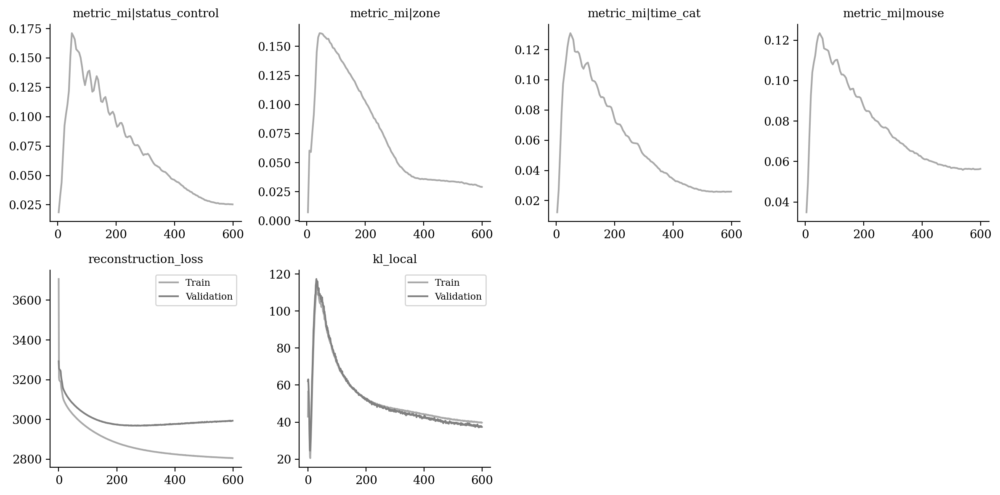

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

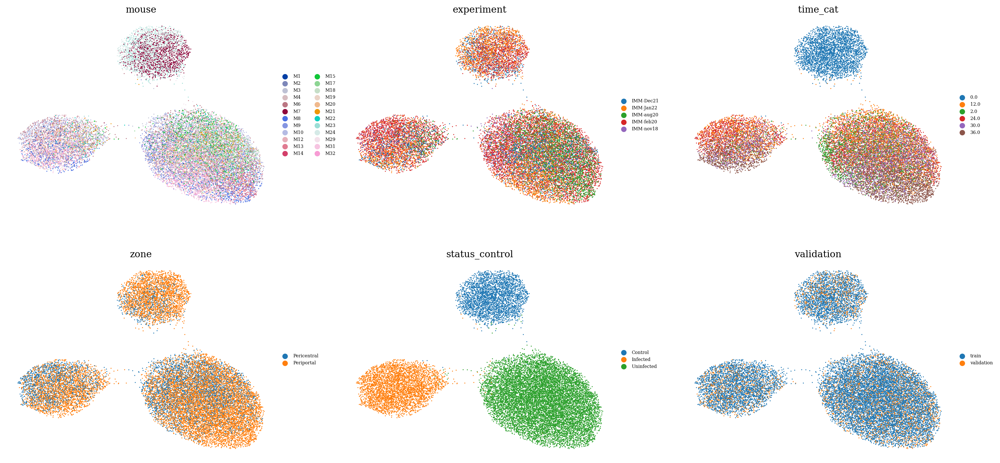

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

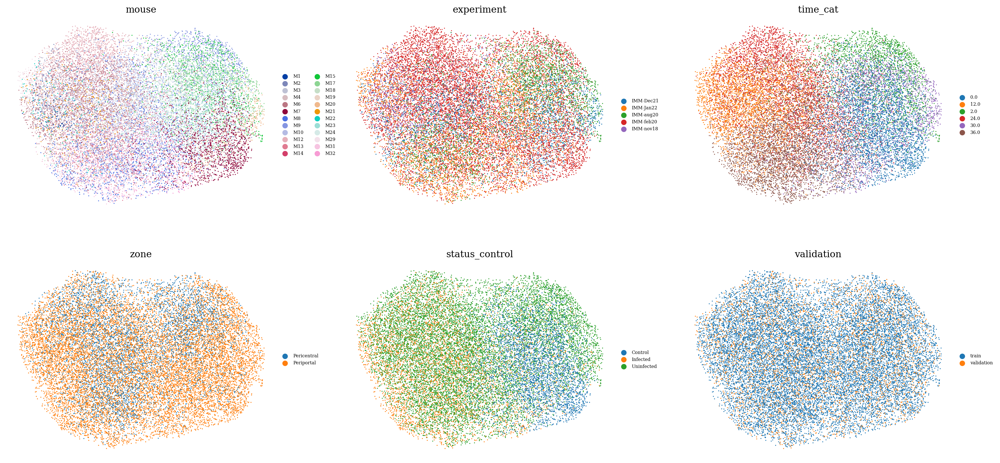

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

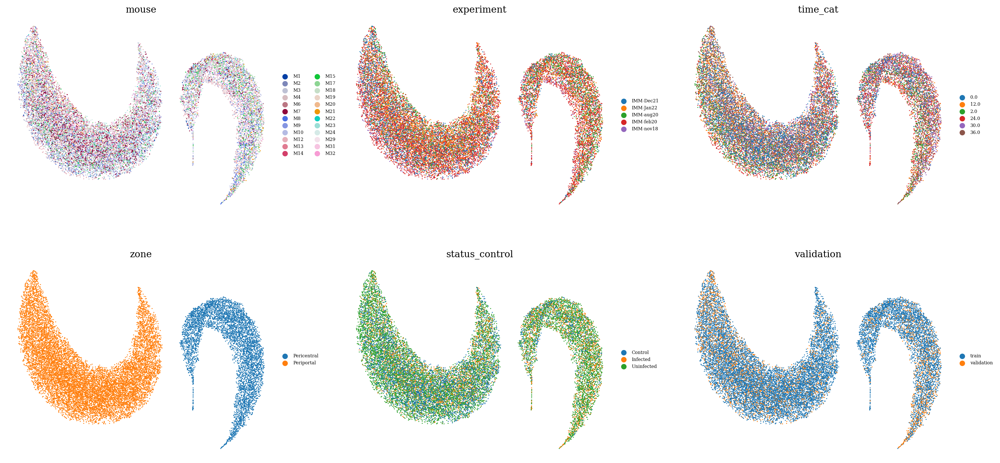

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

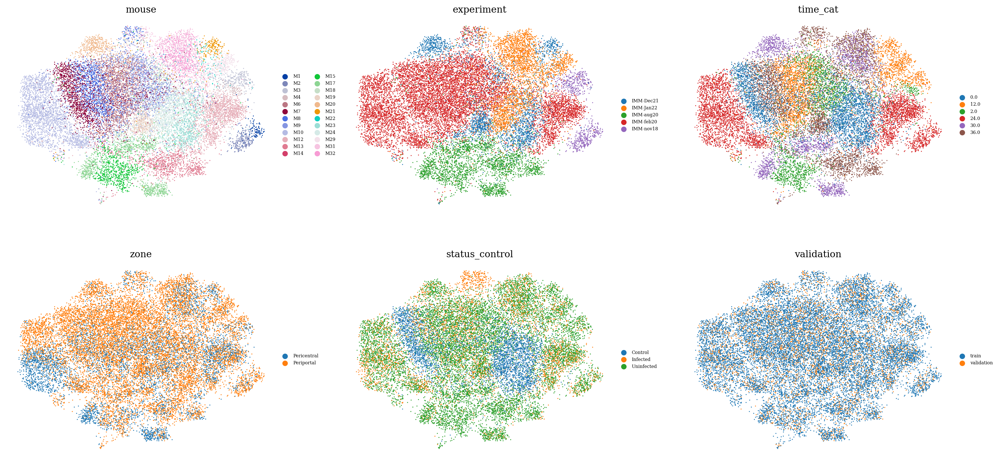

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

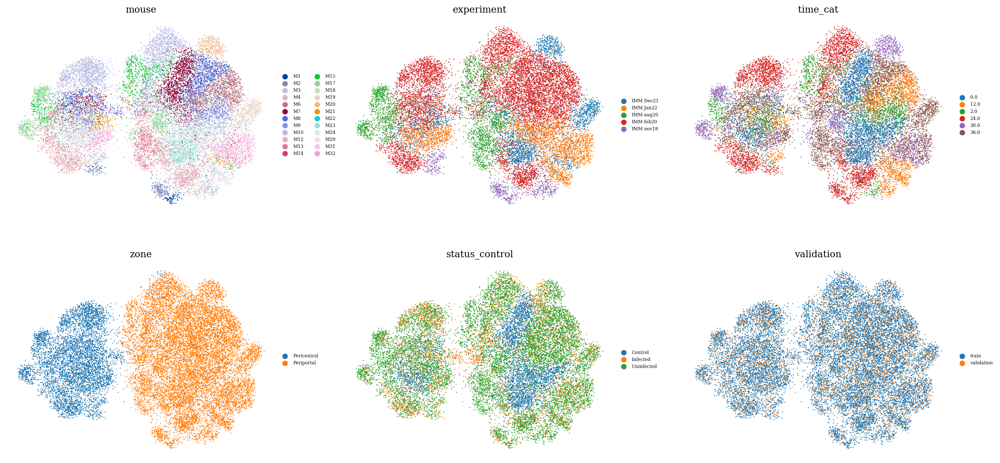

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

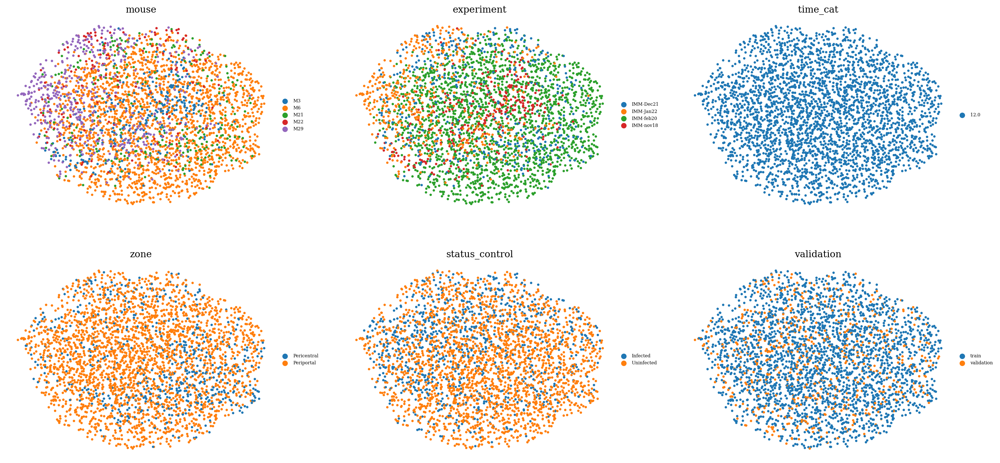

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )